In [1]:
%pip install kaggle==1.5.12
%pip install numpy<2
%pip install torch<2.4
%pip install torchvision
%pip install matplotlib
%pip install pybind11>=2.12

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


The system cannot find the file specified.


Note: you may need to restart the kernel to use updated packages.


The system cannot find the file specified.


  Using cached numpy-1.26.4-cp312-cp312-win_amd64.whl.metadata (61 kB)
  Using cached torch-2.4.0-cp312-cp312-win_amd64.whl.metadata (27 kB)
   ---------------------------------------- 0.0/1.3 MB ? eta -:--:--
    --------------------------------------- 0.0/1.3 MB 1.4 MB/s eta 0:00:01
   --- ------------------------------------ 0.1/1.3 MB 1.5 MB/s eta 0:00:01
   -------- ------------------------------- 0.3/1.3 MB 2.2 MB/s eta 0:00:01
   ------------------- -------------------- 0.6/1.3 MB 3.5 MB/s eta 0:00:01
   -------------------------------------- - 1.2/1.3 MB 5.7 MB/s eta 0:00:01
   ---------------------------------------- 1.3/1.3 MB 5.5 MB/s eta 0:00:00
Using cached torch-2.4.0-cp312-cp312-win_amd64.whl (197.8 MB)
Using cached numpy-1.26.4-cp312-cp312-win_amd64.whl (15.5 MB)
Note: you may need to restart the kernel to use updated packages.
  Using cached matplotlib-3.9.1-cp312-cp312-win_amd64.whl.metadata (11 kB)
Using cached matplotlib-3.9.1-cp312-cp312-win_amd64.whl (8.0 MB)
Note

Prepare kaggle. The very technical steps

In [ ]:
import os
import shutil

# Create a Kaggle folder in the user's home directory
kaggle_dir = os.path.join(os.path.expanduser("~"), ".kaggle")
os.makedirs(kaggle_dir, exist_ok=True)

# Move the kaggle.json file to the .kaggle directory
shutil.move("kaggle.json", os.path.join(kaggle_dir, "kaggle.json"))

# Change the permissions of the file to be read and write for the user only
kaggle_json_path = os.path.join(kaggle_dir, "kaggle.json")
os.chmod(kaggle_json_path, 0o600)

Downloading dataset from kaggle

In [6]:
# Download the dataset
import subprocess

command = [
    'kaggle', 'datasets', 'download', '-d', 'borhanitrash/animal-image-classification-dataset'
]

subprocess.run(command, check=True)

CompletedProcess(args=['kaggle', 'datasets', 'download', '-d', 'borhanitrash/animal-image-classification-dataset'], returncode=0)

In [7]:
import zipfile
import os

# Define the path to the zip file and the extraction directory
zip_file_path = 'animal-image-classification-dataset.zip'
extract_dir = '.'

# Create the extraction directory if it doesn't exist
os.makedirs(extract_dir, exist_ok=True)

# Unzip the file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

print(f"Dataset extracted to {extract_dir}")

Dataset extracted to .


In [8]:
# prompt: I have Animals directory with three directories inside: cats, dogs, snakes. Within each directory there is a banch of images. I need to create within Animals three folders: train, test and validation. Each folder should have similar structure: cats, dogs and snakes. train should contain 75 % of images, test 20% and validate 5 %. validate folder should not be split to categories (cats, dogs, snakes

import os
import shutil
import random

# Define the source directory and the target directory
source_dir = "Animals"
target_dir = "Animals_splitted"

# Create the target directory if it doesn't exist
os.makedirs(target_dir, exist_ok=True)

# Create subdirectories for train, test, and validation
for split in ["train", "test", "validation"]:
  split_dir = os.path.join(target_dir, split)
  os.makedirs(split_dir, exist_ok=True)
  if split != "validation":
    for animal in ["cats", "dogs", "snakes"]:
      animal_dir = os.path.join(split_dir, animal)
      os.makedirs(animal_dir, exist_ok=True)

# Iterate over the animal directories in the source directory
for animal in ["cats", "dogs", "snakes"]:
  animal_dir = os.path.join(source_dir, animal)
  image_files = os.listdir(animal_dir)
  random.shuffle(image_files)

  # Calculate the number of images for each split
  num_images = len(image_files)
  num_train = int(0.75 * num_images)
  num_test = int(0.20 * num_images)
  num_validation = num_images - num_train - num_test

  # Copy images to the corresponding split directories
  for i, image_file in enumerate(image_files):
    source_path = os.path.join(animal_dir, image_file)
    if i < num_train:
      target_path = os.path.join(target_dir, "train", animal, image_file)
    elif i < num_train + num_test:
      target_path = os.path.join(target_dir, "test", animal, image_file)
    else:
      target_path = os.path.join(target_dir, "validation", image_file)
    shutil.copy(source_path, target_path)

print("Dataset splitted successfully!")


Dataset splitted successfully!


Преобразовываем данные и добавляем аугментацию

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, models, transforms
import time
import os
import copy

from tqdm import tqdm

from torch.optim import lr_scheduler

# Define transformations
data_transforms = {
    'train': transforms.Compose([
        transforms.RandomResizedCrop(224), # приведение к одному размеру
        transforms.RandomHorizontalFlip(), # аугментация - отзеркаливание
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) # нормализация по каналам
    ]),
    'test': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}



In [2]:
data_dir = 'Animals_splitted'
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x]) for x in ['train', 'test']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=32, shuffle=True, num_workers=4) for x in ['train', 'test']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'test']}
class_names = image_datasets['train'].classes

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('Running model on ', device)

Running model on  cpu


Визуализируем датасет

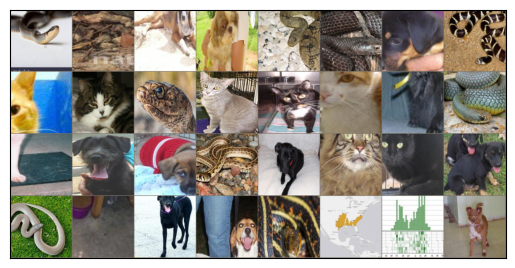

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision

# Function to show images
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    plt.xticks([])  # Remove x-ticks
    plt.yticks([])  # Remove y-ticks
    plt.pause(0.001)  # pause a bit so that plots are updated

# Get a batch of training data
inputs, classes = next(iter(dataloaders['train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

# Plot the images
imshow(out, title=[class_names[x] for x in classes])

Прописываем общую функцию для обучения

In [4]:
# Function to train the model
def train_model(model, criterion, optimizer, scheduler, num_epochs=5):
    since = time.time()
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        for phase in ['train', 'test']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0

            for inputs, labels in tqdm(dataloaders[phase]):
                inputs = inputs.to(device)
                labels = labels.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            if phase == 'test' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val Acc: {best_acc:.4f}')

    model.load_state_dict(best_model_wts)
    return model

Создаём две модели: одну будем обучать с нуля, а другую дообучим на предобученной модели

In [5]:
# Load ResNet-18 model trained from scratch
model_ft_scratch = models.resnet18(pretrained=False) # НЕ предобученная модель (pretrained=False)
num_ftrs = model_ft_scratch.fc.in_features
model_ft_scratch.fc = nn.Linear(num_ftrs, len(class_names)) # задаем 3 класса на выходе
model_ft_scratch = model_ft_scratch.to(device)

criterion = nn.CrossEntropyLoss() # Задаем функцию потерь

optimizer_ft_scratch = optim.SGD(model_ft_scratch.parameters(), lr=0.001, momentum=0.9)
exp_lr_scheduler_scratch = lr_scheduler.StepLR(optimizer_ft_scratch, step_size=7, gamma=0.1)

# Запускаем обучение на 5 эпох
print("Training ResNet-18 from scratch")
model_ft_scratch = train_model(model_ft_scratch, criterion, optimizer_ft_scratch, exp_lr_scheduler_scratch, num_epochs=5)

# Задаем предобученную на ImageNet модель.
model_ft_pretrained = models.resnet18(weights='IMAGENET1K_V1')

# Замораживаем все слои модели
for param in model_ft_pretrained.parameters():
    param.requires_grad = False

num_ftrs = model_ft_pretrained.fc.in_features
model_ft_pretrained.fc = nn.Linear(num_ftrs, len(class_names)) # При перезаписи, новый слой будет "разморожен"
model_ft_pretrained = model_ft_pretrained.to(device) # Отправляем на GPU

# Указываем оптимизатору, что только последний слой надо обновлять
optimizer_ft_pretrained = optim.SGD(model_ft_pretrained.fc.parameters(), lr=0.001, momentum=0.9)

exp_lr_scheduler_pretrained = lr_scheduler.StepLR(optimizer_ft_pretrained, step_size=7, gamma=0.1)

# Запускаем обучение на 5 эпох
print("Fine-tuning pretrained ResNet-18")
model_ft_pretrained = train_model(model_ft_pretrained, criterion, optimizer_ft_pretrained, exp_lr_scheduler_pretrained, num_epochs=5)

c:\Projects\AI\zerocoder\fine-tuning\.venv\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Projects\AI\zerocoder\fine-tuning\.venv\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Training ResNet-18 from scratch
Epoch 0/4
----------


100%|██████████| 71/71 [04:03<00:00,  3.43s/it]


train Loss: 0.9847 Acc: 0.4938


100%|██████████| 19/19 [00:24<00:00,  1.30s/it]


test Loss: 1.1725 Acc: 0.4200
Epoch 1/4
----------


100%|██████████| 71/71 [04:05<00:00,  3.46s/it]


train Loss: 0.9053 Acc: 0.5369


100%|██████████| 19/19 [00:24<00:00,  1.29s/it]


test Loss: 0.8301 Acc: 0.6017
Epoch 2/4
----------


100%|██████████| 71/71 [03:54<00:00,  3.30s/it]


train Loss: 0.8622 Acc: 0.5698


100%|██████████| 19/19 [00:24<00:00,  1.28s/it]


test Loss: 0.9731 Acc: 0.5050
Epoch 3/4
----------


100%|██████████| 71/71 [04:46<00:00,  4.04s/it]


train Loss: 0.8317 Acc: 0.5933


100%|██████████| 19/19 [00:24<00:00,  1.31s/it]


test Loss: 0.7995 Acc: 0.5700
Epoch 4/4
----------


100%|██████████| 71/71 [03:51<00:00,  3.27s/it]


train Loss: 0.8135 Acc: 0.5964


100%|██████████| 19/19 [00:24<00:00,  1.27s/it]
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to C:\Users\volko/.cache\torch\hub\checkpoints\resnet18-f37072fd.pth


test Loss: 0.7997 Acc: 0.6067
Training complete in 22m 45s
Best val Acc: 0.6067


100%|██████████| 44.7M/44.7M [00:01<00:00, 46.7MB/s]


Fine-tuning pretrained ResNet-18
Epoch 0/4
----------


100%|██████████| 71/71 [01:59<00:00,  1.68s/it]


train Loss: 0.4203 Acc: 0.8596


100%|██████████| 19/19 [00:25<00:00,  1.35s/it]


test Loss: 0.1188 Acc: 0.9667
Epoch 1/4
----------


100%|██████████| 71/71 [02:43<00:00,  2.31s/it]


train Loss: 0.2044 Acc: 0.9387


100%|██████████| 19/19 [00:39<00:00,  2.09s/it]


test Loss: 0.0908 Acc: 0.9683
Epoch 2/4
----------


100%|██████████| 71/71 [02:36<00:00,  2.21s/it]


train Loss: 0.1775 Acc: 0.9356


100%|██████████| 19/19 [00:40<00:00,  2.11s/it]


test Loss: 0.0841 Acc: 0.9683
Epoch 3/4
----------


100%|██████████| 71/71 [02:40<00:00,  2.27s/it]


train Loss: 0.1664 Acc: 0.9378


100%|██████████| 19/19 [00:39<00:00,  2.08s/it]


test Loss: 0.0748 Acc: 0.9700
Epoch 4/4
----------


100%|██████████| 71/71 [02:35<00:00,  2.19s/it]


train Loss: 0.1436 Acc: 0.9471


100%|██████████| 19/19 [00:39<00:00,  2.07s/it]

test Loss: 0.0736 Acc: 0.9717
Training complete in 15m 40s
Best val Acc: 0.9717


Сохраняем модели

In [15]:
import torch
import os

# Create the directory if it does not exist
if not os.path.exists('models'):
    os.makedirs('models')

# Save the model state dictionary
torch.save(model_ft_pretrained.state_dict(), 'models/model_ft_pretrained.pth')
torch.save(model_ft_scratch.state_dict(), 'models/model_ft_scratch.pth')

# Optionally, save the entire model including optimizer and other metadata
torch.save({
    'epoch': 5,
    'model_state_dict': model_ft_pretrained.state_dict(),
    'optimizer_state_dict': optimizer_ft_pretrained.state_dict(),
    'loss': criterion,
}, 'models/model_ft_pretrained_full.pth')


Run both models on validation set

Image: 0_0001.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


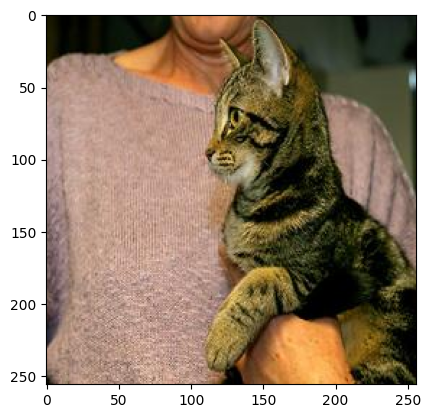

Image: 0_0002.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


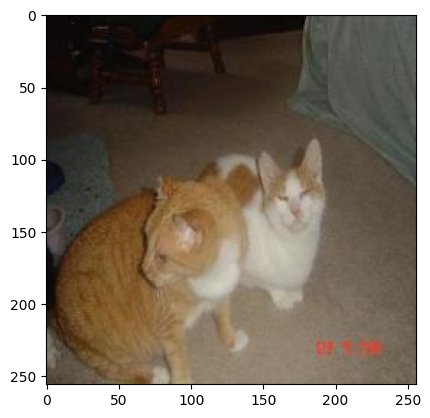

Image: 0_0037.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


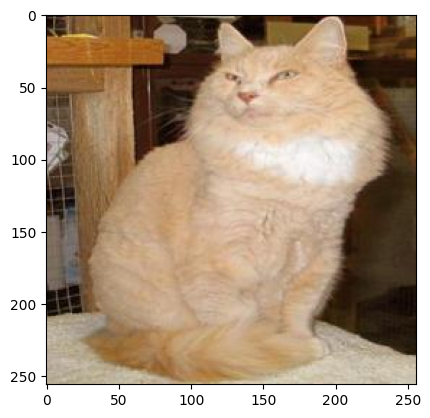

Image: 0_0074.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


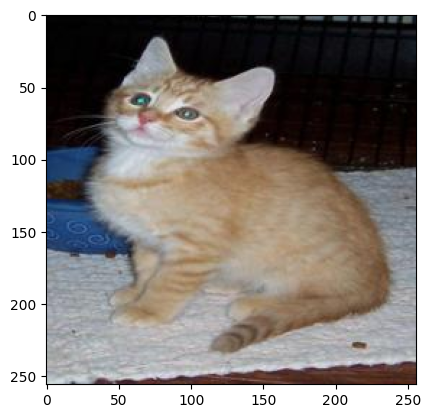

Image: 0_0079.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


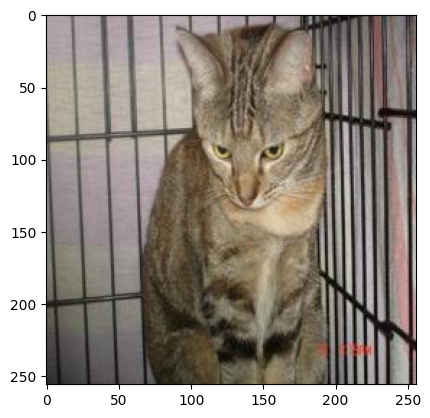

Image: 0_0118.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


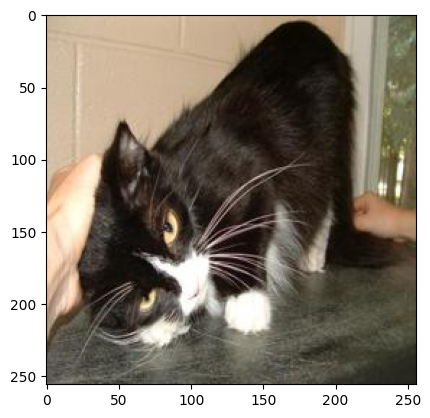

Image: 0_0125.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


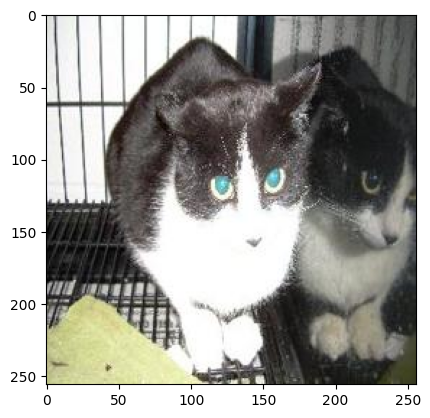

Image: 0_0126.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


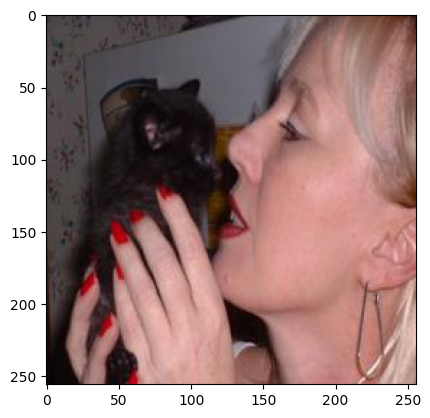

Image: 0_0131.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


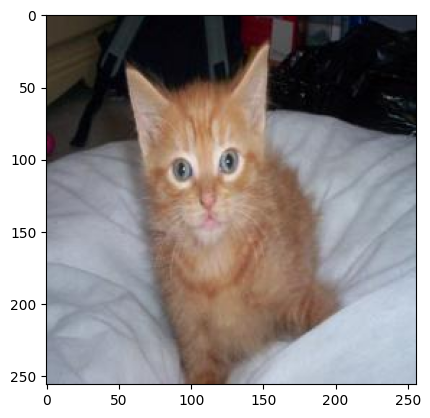

Image: 0_0187.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


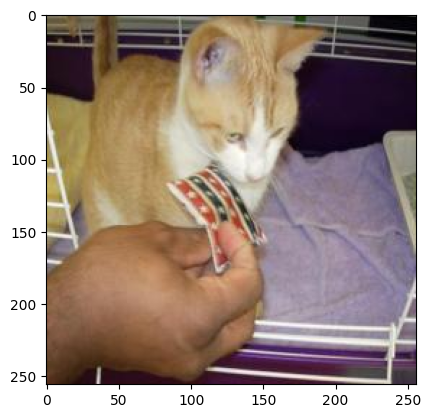

Image: 0_0253.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


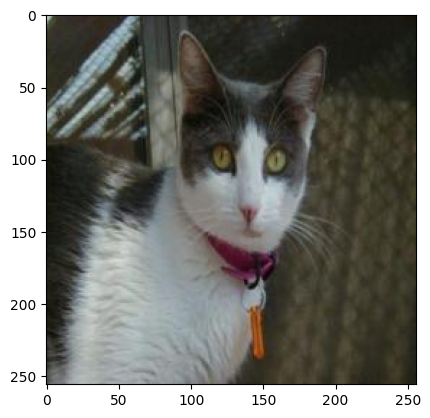

Image: 0_0255.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


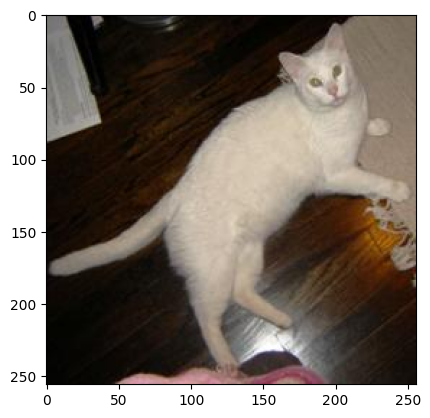

Image: 0_0282.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


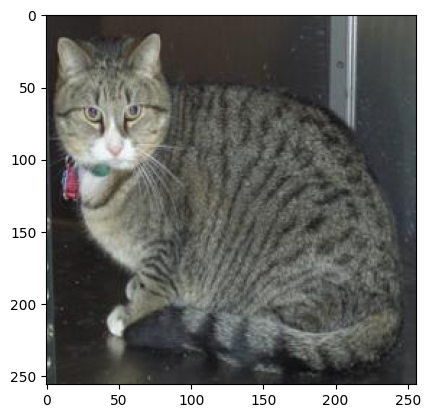

Image: 0_0285.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


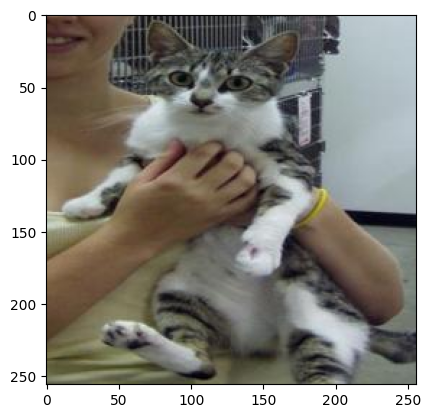

Image: 0_0317.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


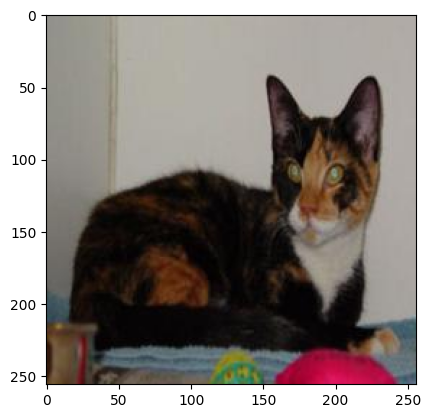

Image: 0_0344.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


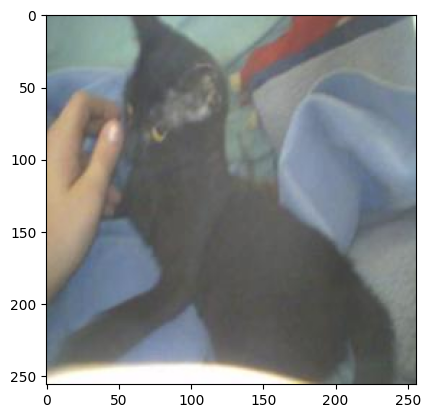

Image: 0_0352.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


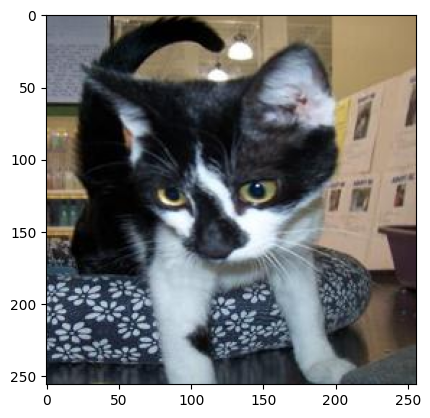

Image: 0_0392.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


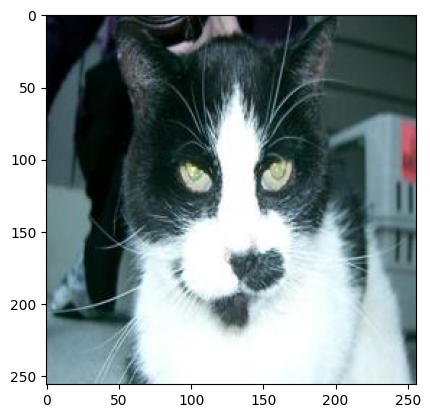

Image: 0_0414.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


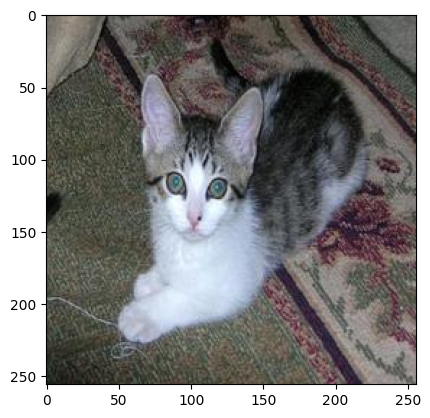

Image: 0_0428.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


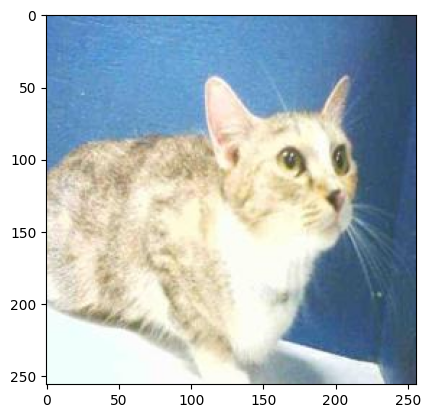

Image: 0_0432.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


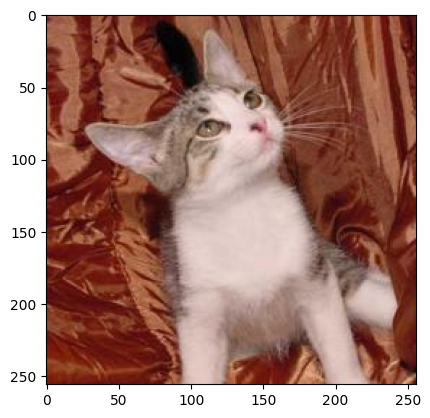

Image: 0_0435.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


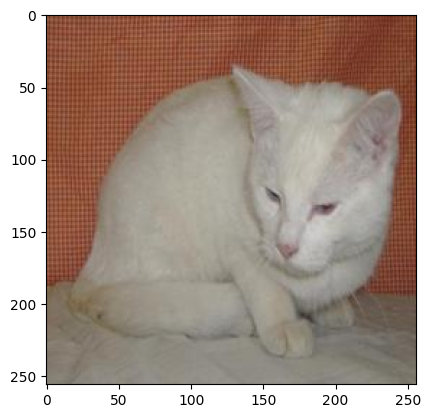

Image: 0_0448.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


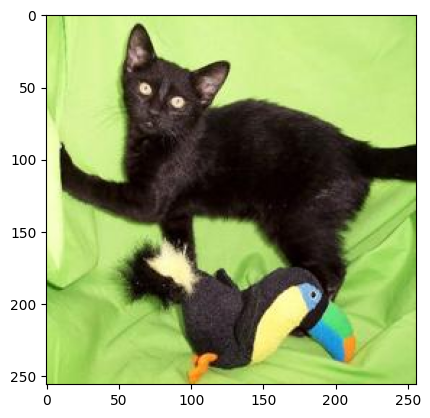

Image: 0_0470.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


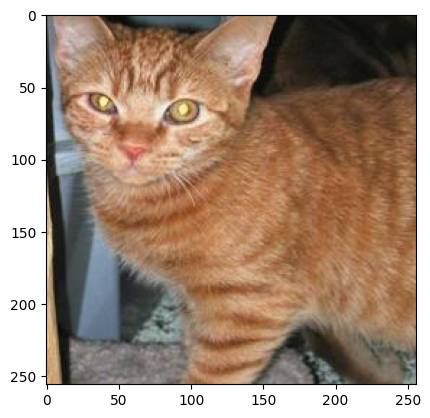

Image: 0_0472.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


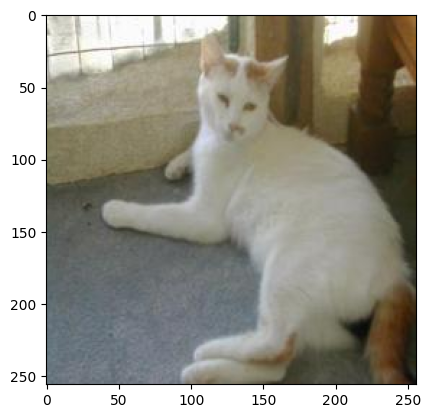

Image: 0_0497.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


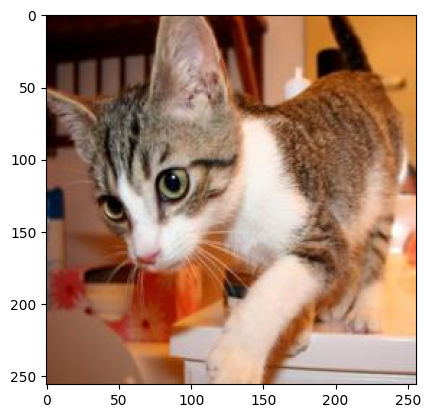

Image: 0_0505.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


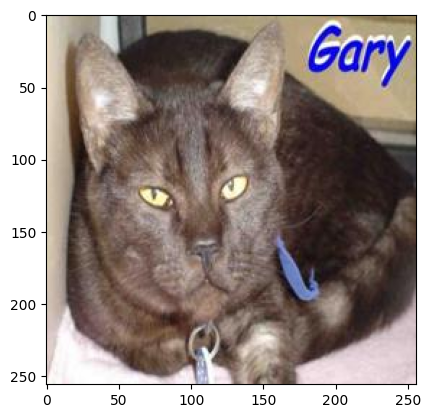

Image: 0_0535.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


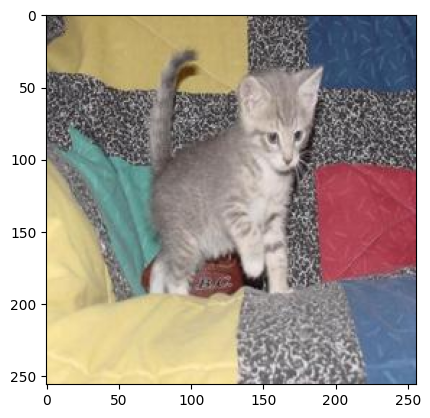

Image: 0_0601.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


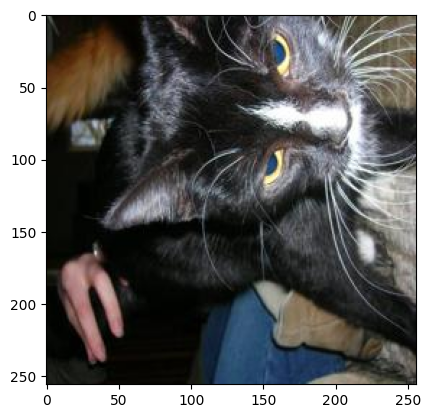

Image: 0_0602.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


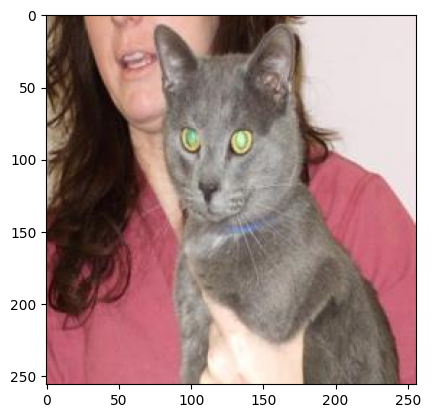

Image: 0_0622.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


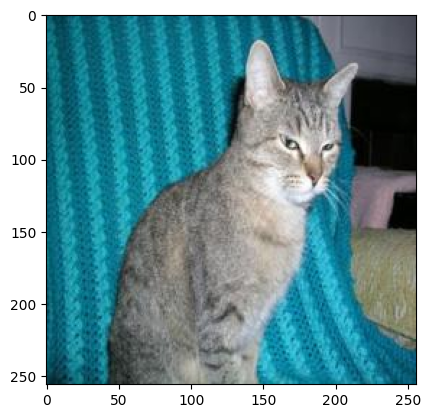

Image: 0_0665.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


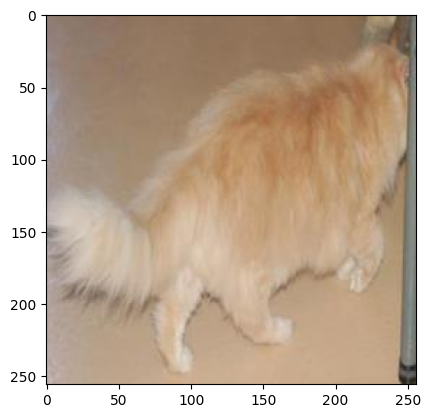

Image: 0_0720.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


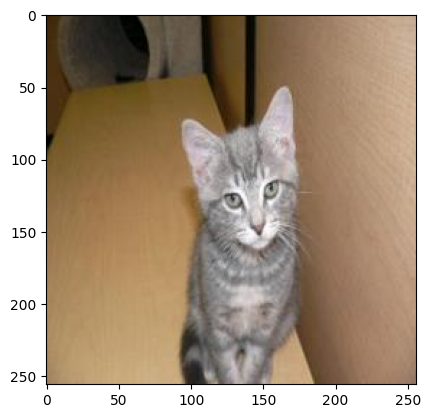

Image: 0_0721.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


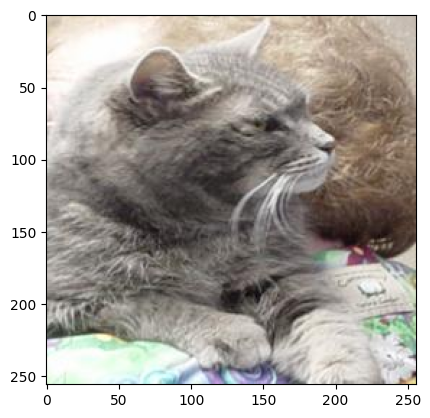

Image: 0_0726.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


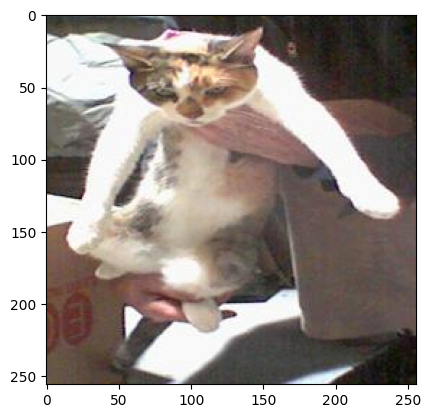

Image: 0_0738.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


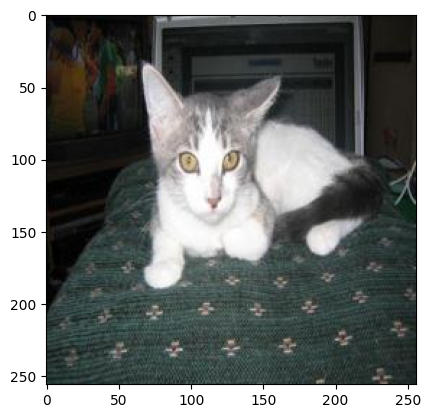

Image: 0_0748.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


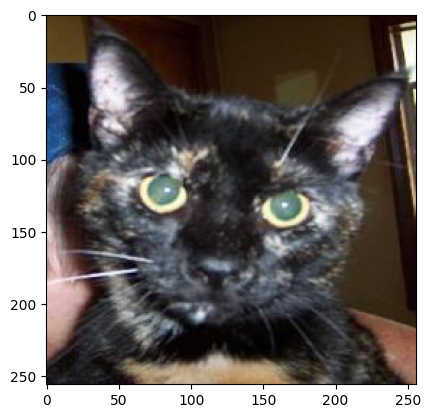

Image: 0_0763.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


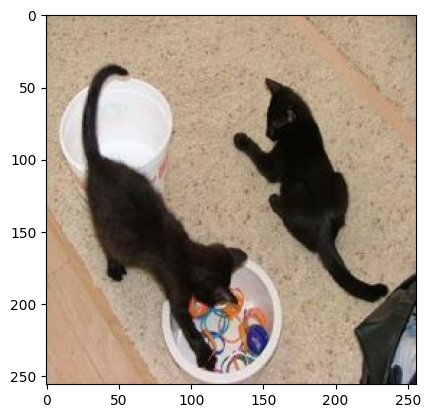

Image: 0_0781.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


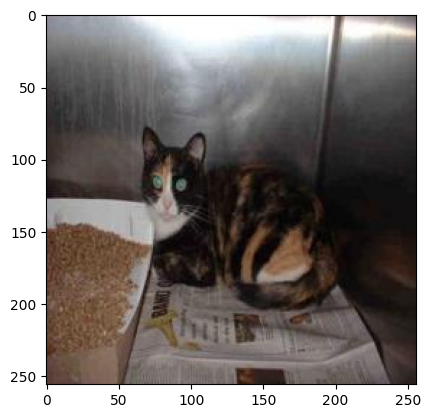

Image: 0_0788.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


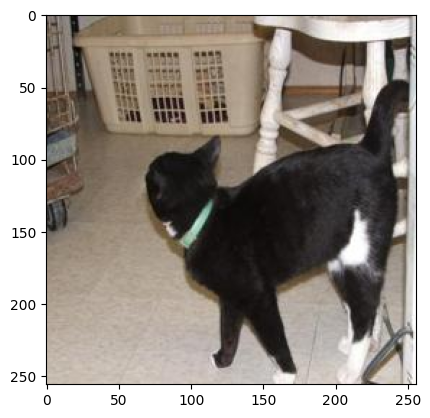

Image: 0_0793.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


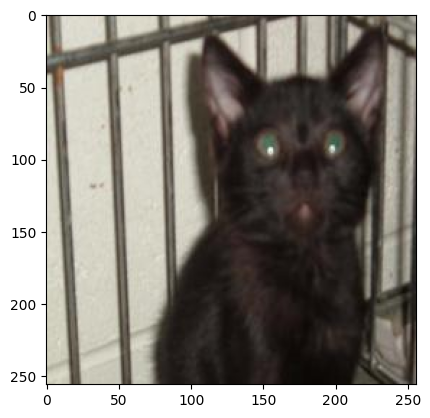

Image: 0_0794.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


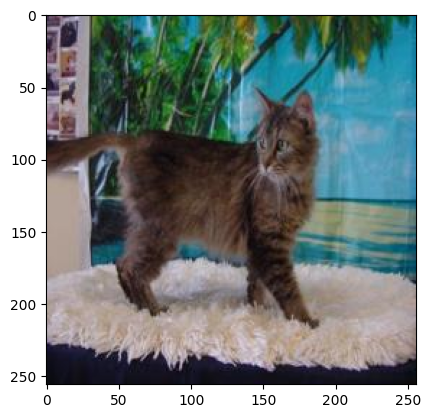

Image: 0_0802.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


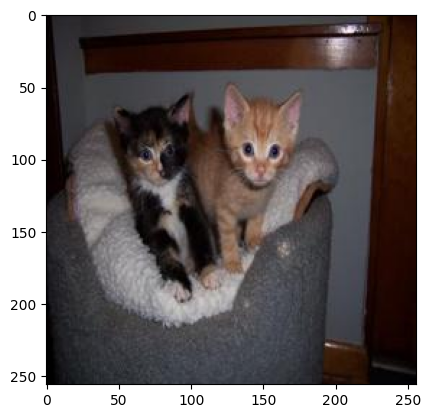

Image: 0_0821.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


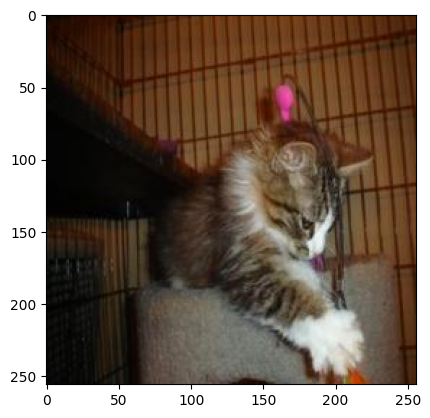

Image: 0_0824.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


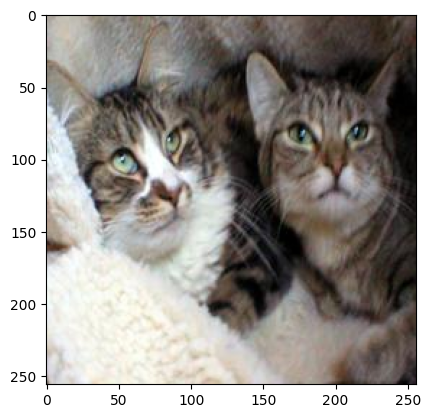

Image: 0_0863.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


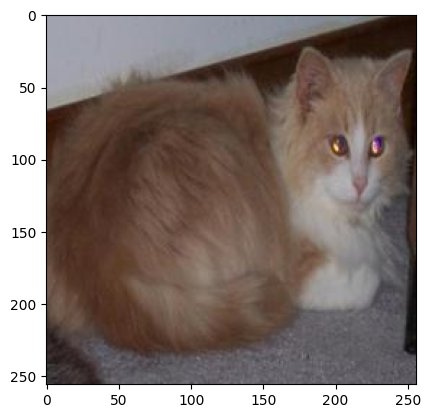

Image: 0_0881.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


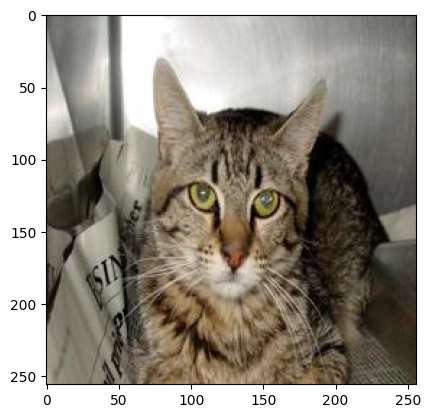

Image: 0_0906.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


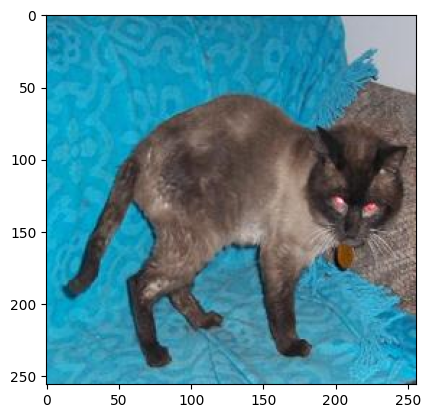

Image: 0_0939.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


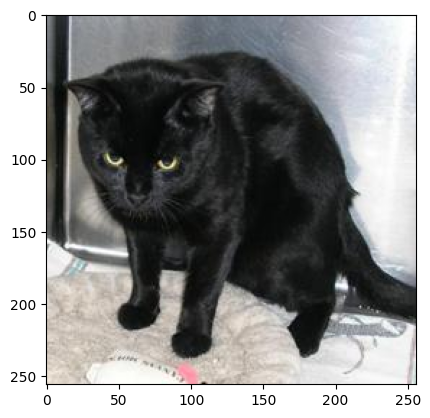

Image: 0_0995.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


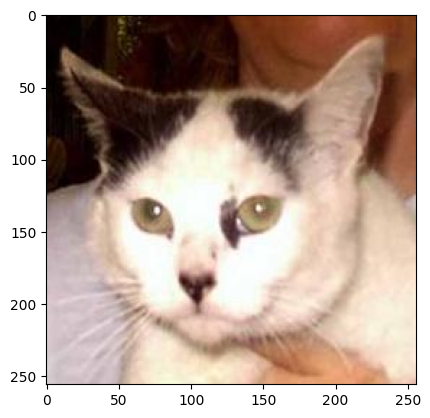

Image: 1_0041.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


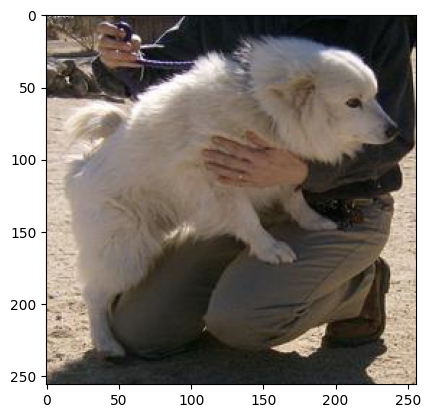

Image: 1_0067.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


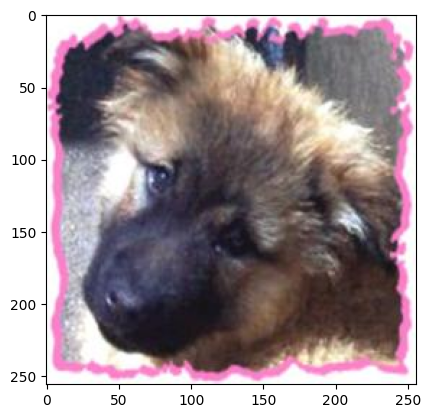

Image: 1_0083.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


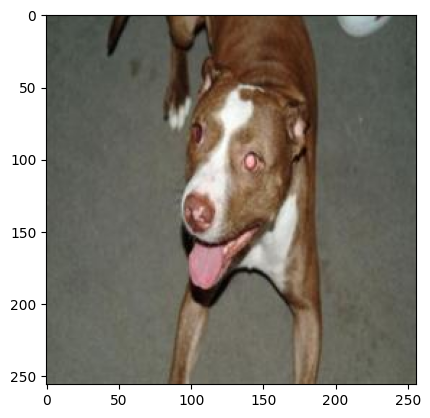

Image: 1_0086.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


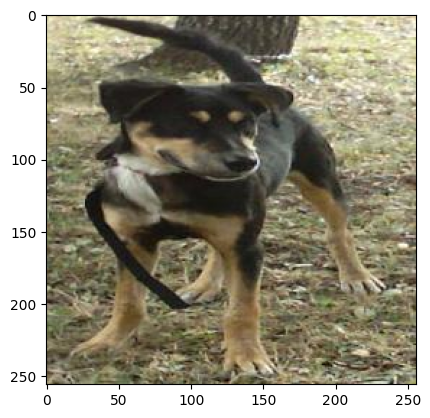

Image: 1_0133.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


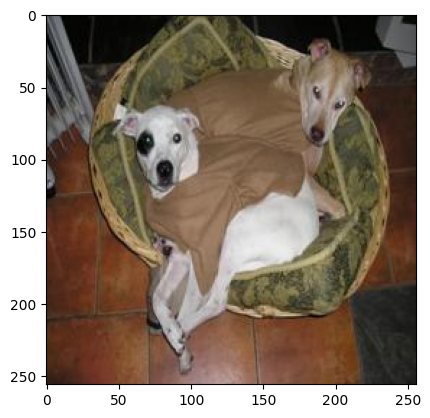

Image: 1_0176.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


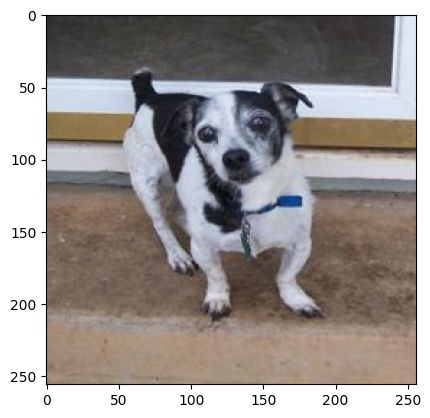

Image: 1_0185.jpg
Class predicted by model trained from scratch: dogs
Class predicted by fine-tuned pretrained model: dogs


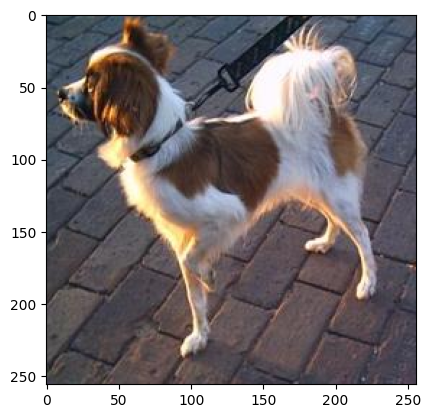

Image: 1_0188.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


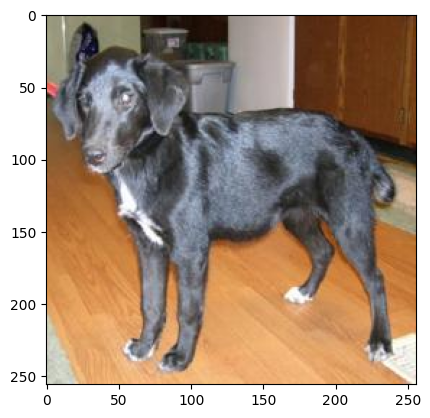

Image: 1_0213.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


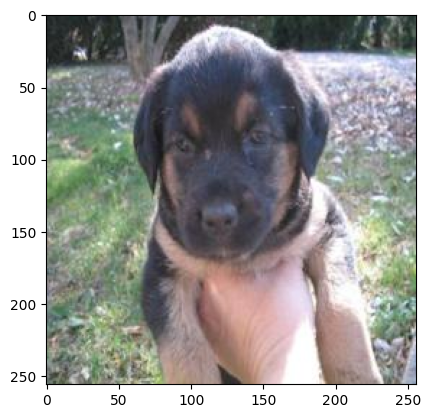

Image: 1_0222.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


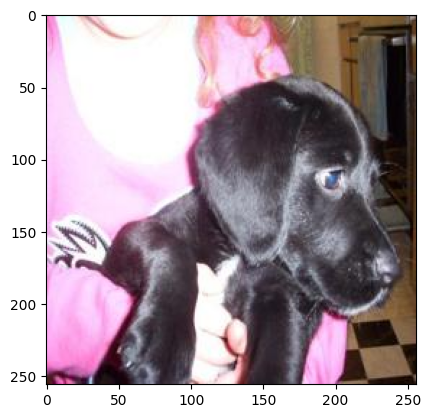

Image: 1_0225.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


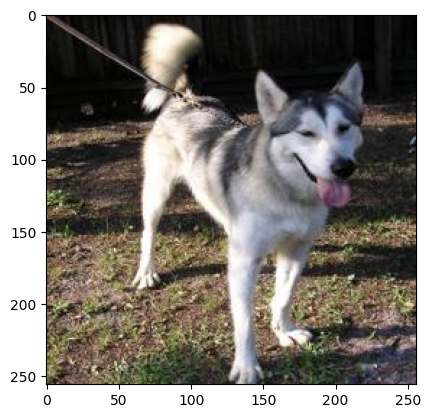

Image: 1_0231.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


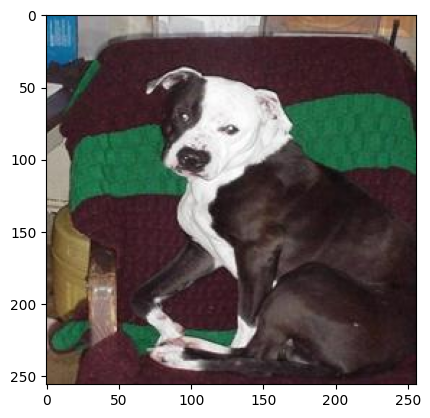

Image: 1_0236.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


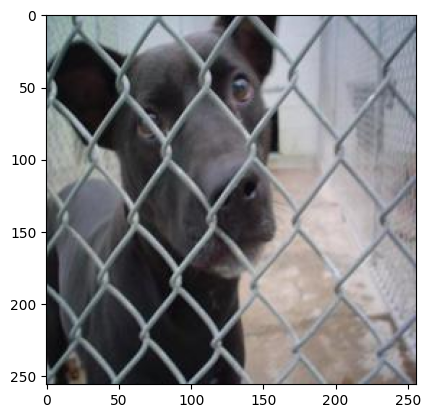

Image: 1_0258.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


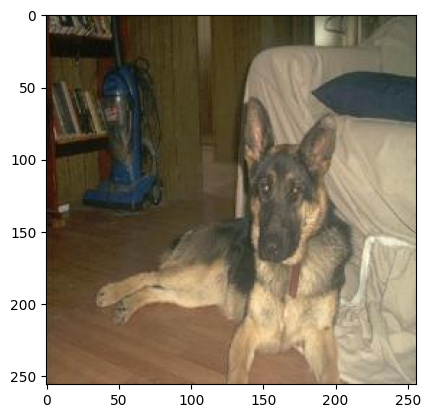

Image: 1_0261.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


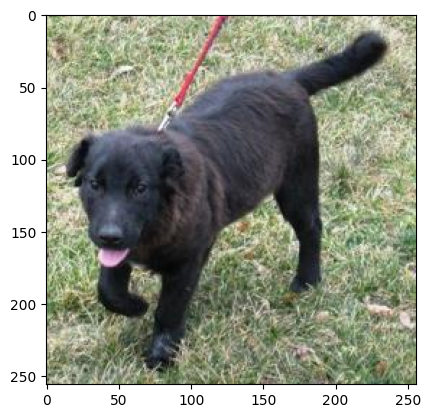

Image: 1_0281.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


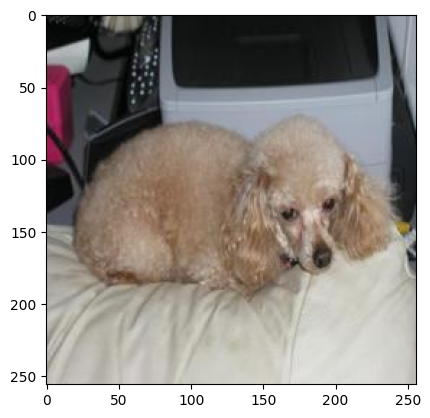

Image: 1_0299.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


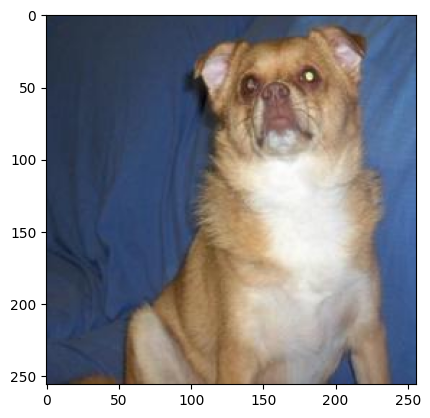

Image: 1_0336.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


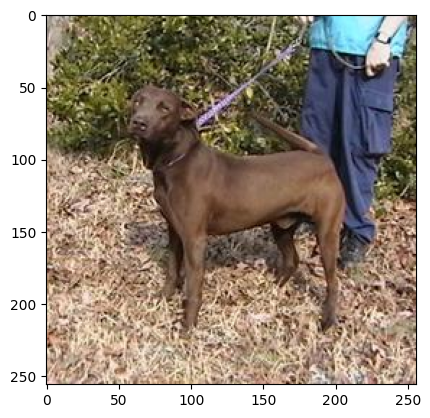

Image: 1_0351.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


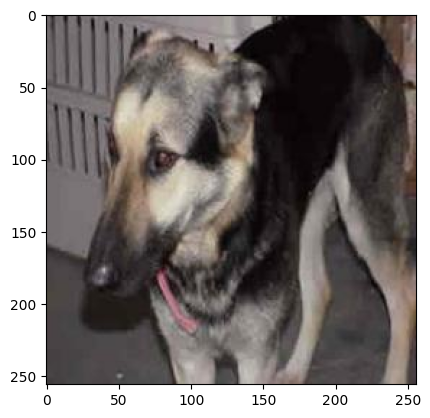

Image: 1_0375.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


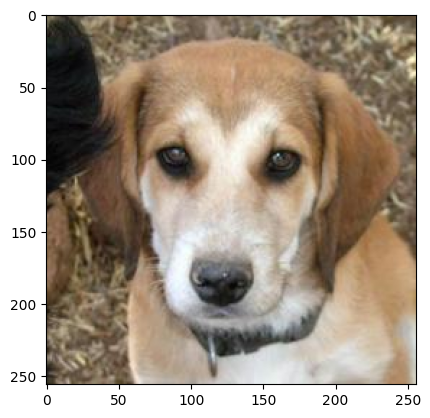

Image: 1_0376.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


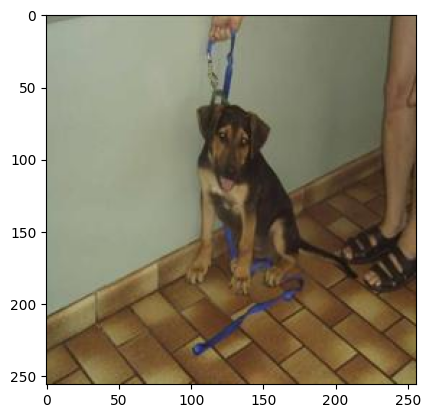

Image: 1_0391.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


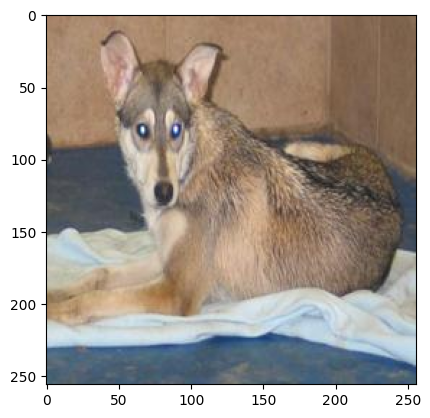

Image: 1_0400.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


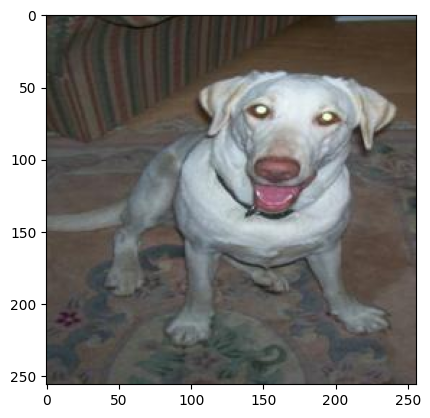

Image: 1_0444.jpg
Class predicted by model trained from scratch: dogs
Class predicted by fine-tuned pretrained model: dogs


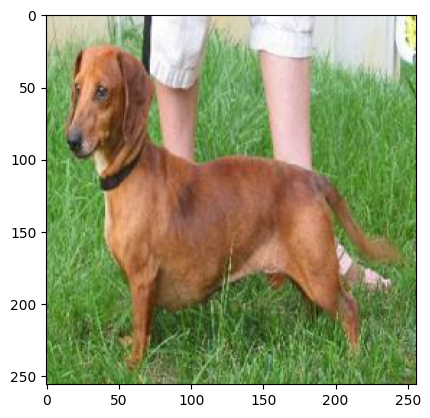

Image: 1_0453.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


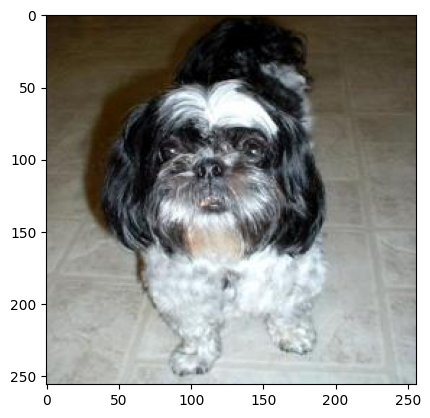

Image: 1_0457.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


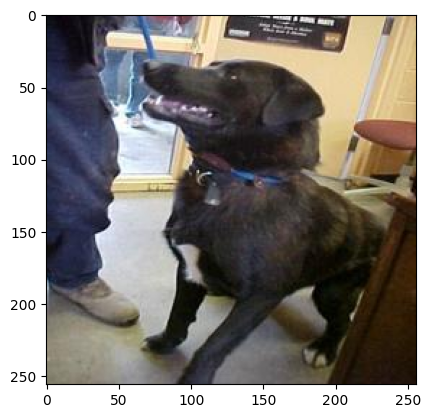

Image: 1_0462.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


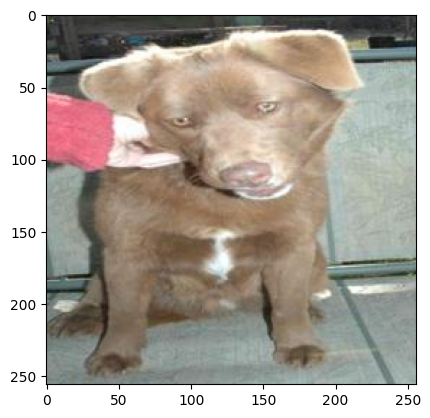

Image: 1_0522.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


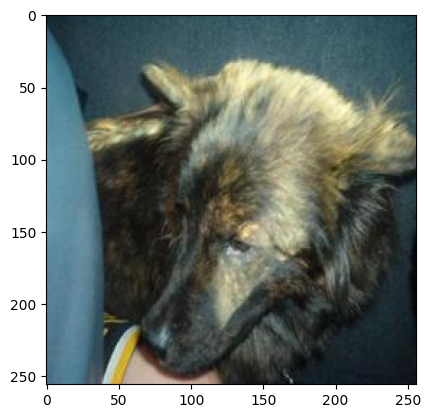

Image: 1_0538.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


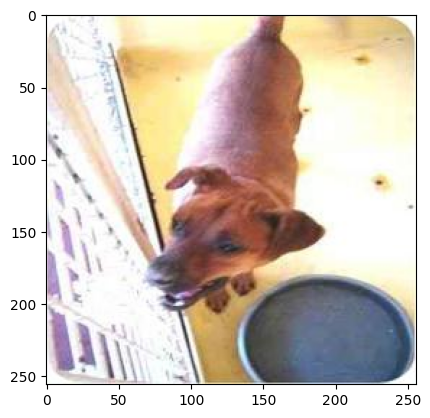

Image: 1_0568.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


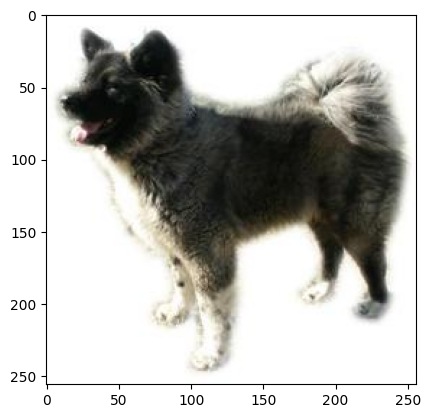

Image: 1_0577.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


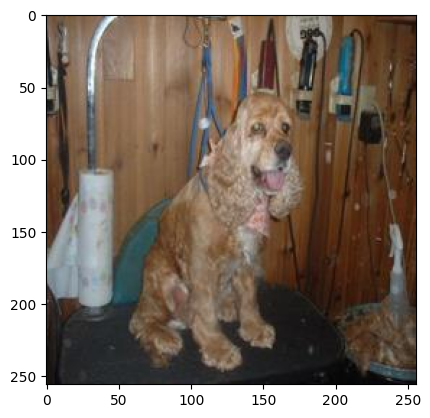

Image: 1_0595.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


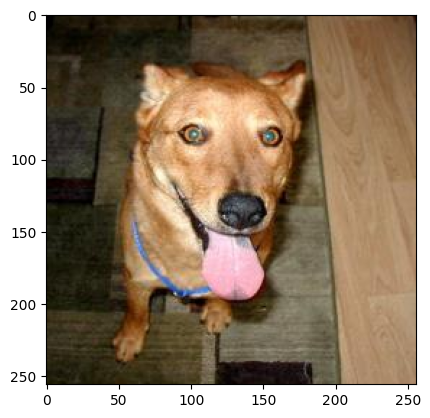

Image: 1_0596.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


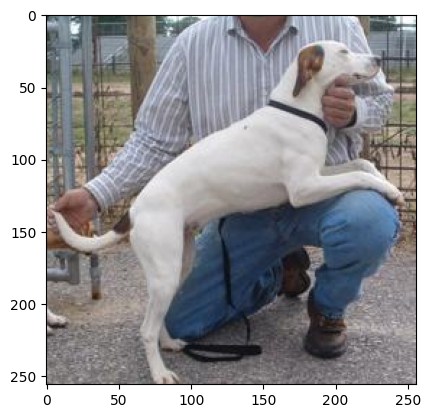

Image: 1_0606.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


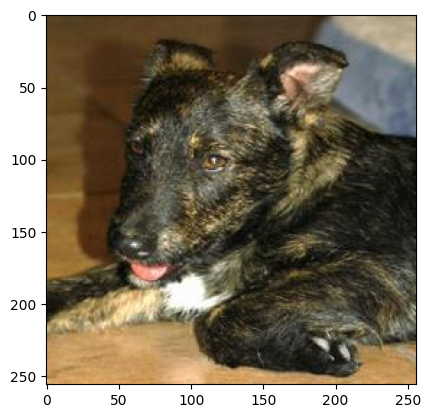

Image: 1_0623.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


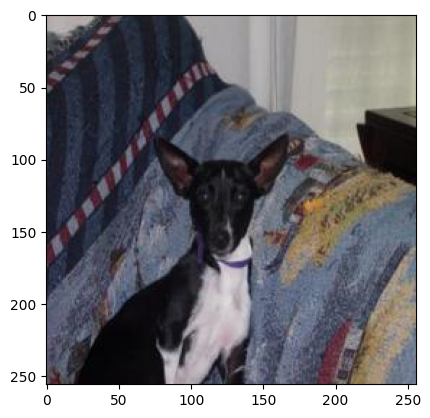

Image: 1_0656.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


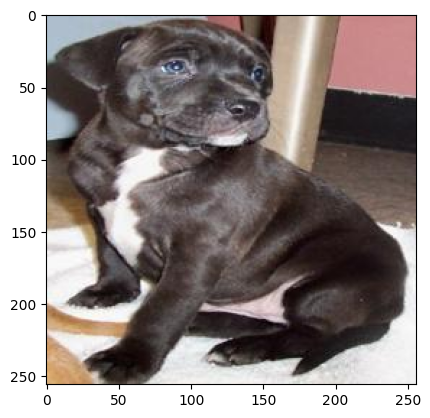

Image: 1_0685.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


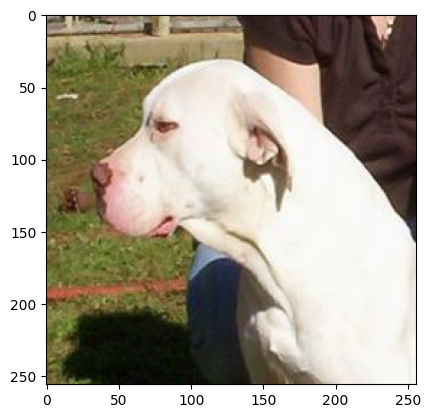

Image: 1_0698.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


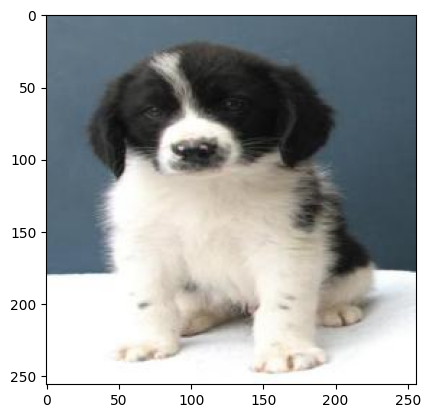

Image: 1_0741.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


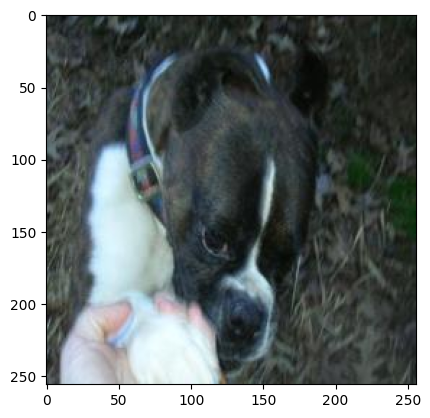

Image: 1_0744.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


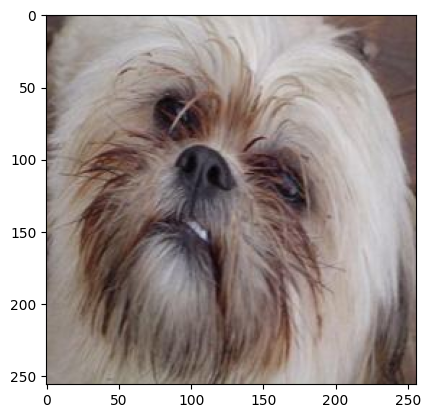

Image: 1_0768.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


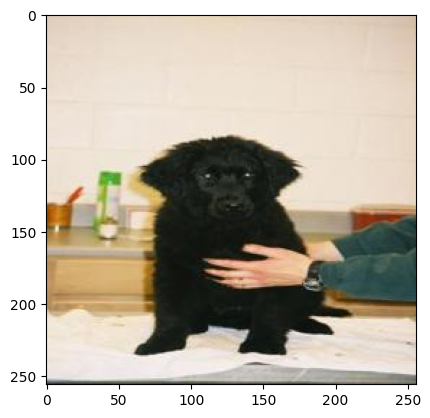

Image: 1_0797.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


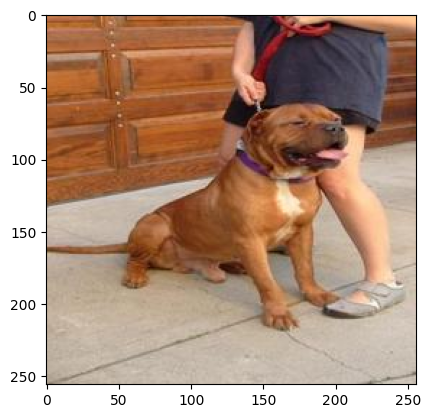

Image: 1_0811.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


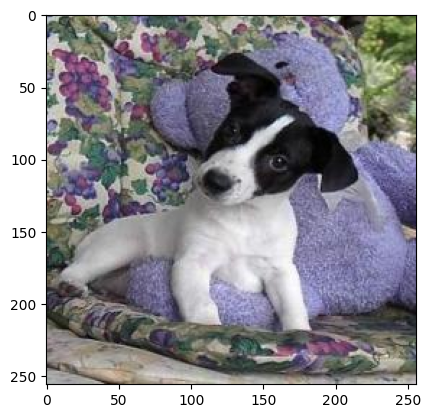

Image: 1_0845.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


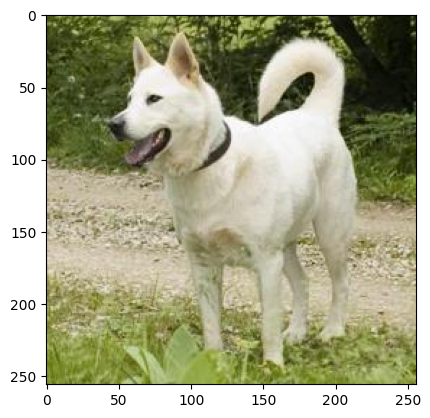

Image: 1_0900.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


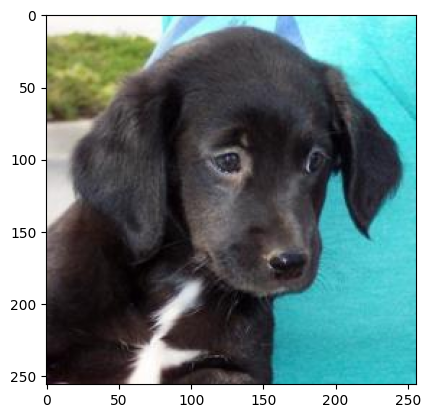

Image: 1_0906.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


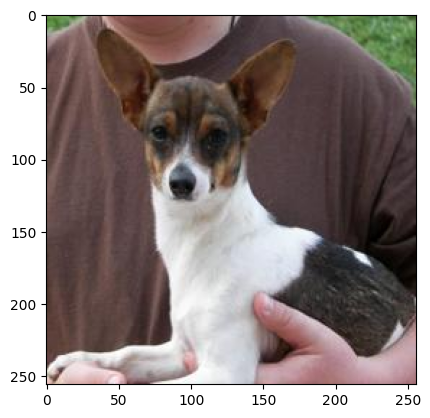

Image: 1_0909.jpg
Class predicted by model trained from scratch: dogs
Class predicted by fine-tuned pretrained model: dogs


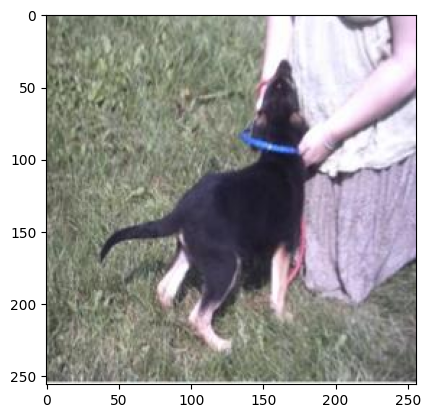

Image: 1_0927.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


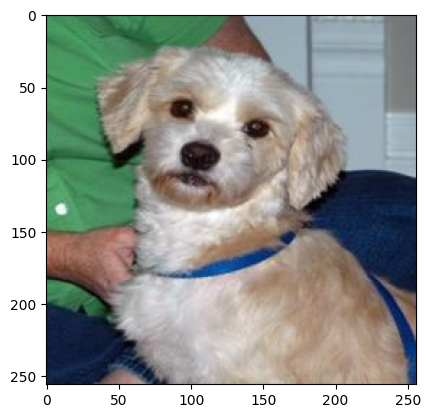

Image: 1_0938.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: dogs


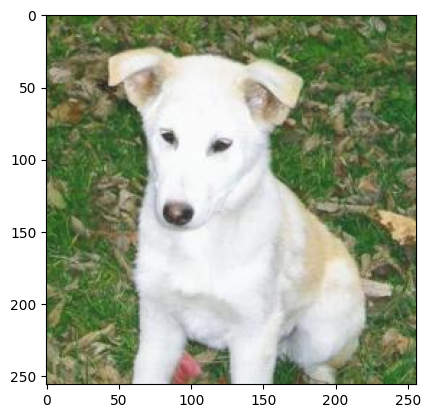

Image: 1_0949.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: dogs


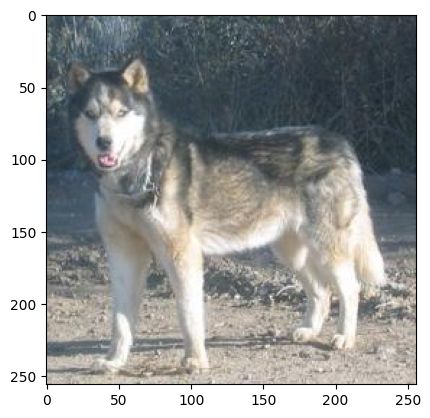

Image: 2_0007.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


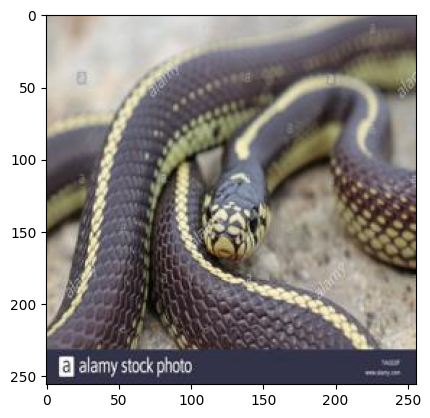

Image: 2_0041.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


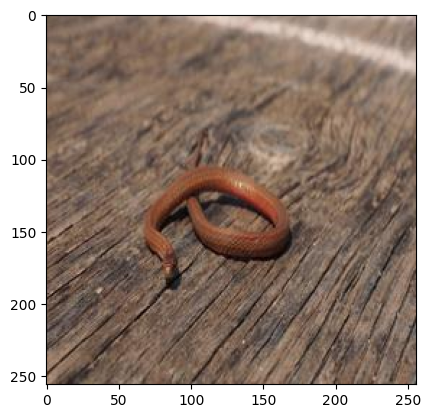

Image: 2_0060.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


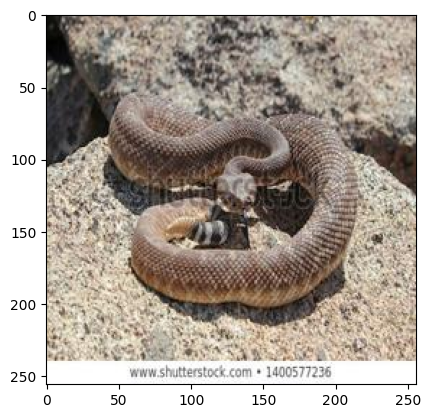

Image: 2_0101.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


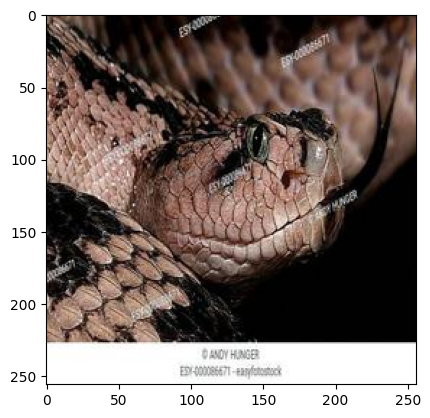

Image: 2_0144.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


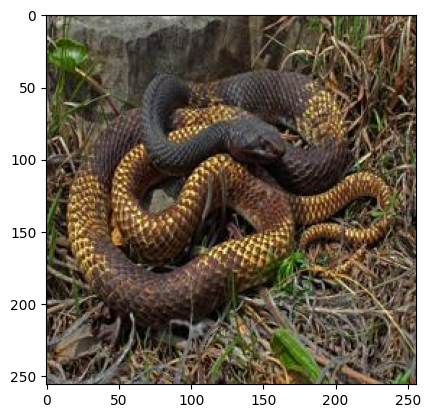

Image: 2_0177.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


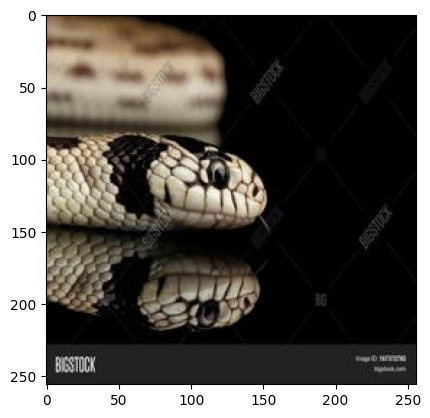

Image: 2_0180.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


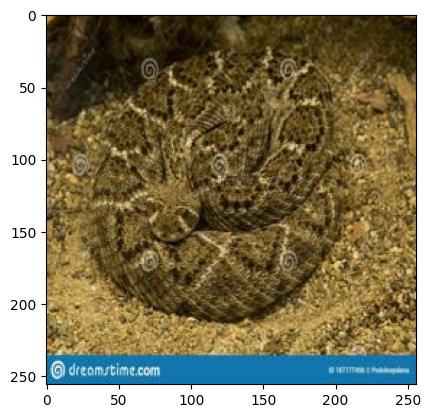

Image: 2_0213.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


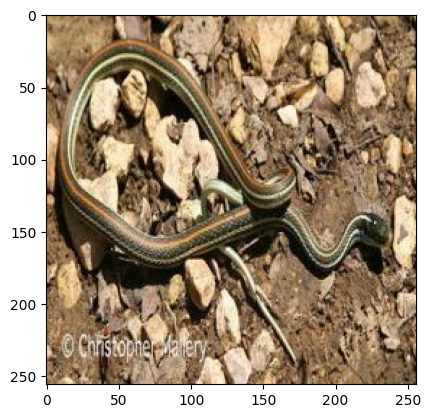

Image: 2_0242.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


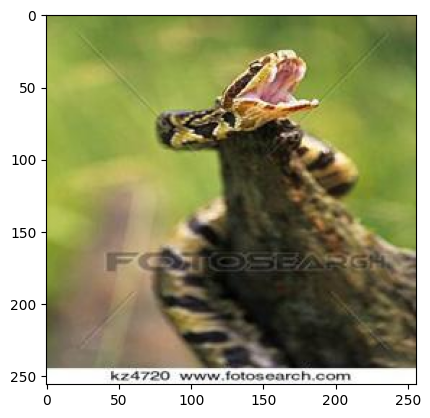

Image: 2_0274.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


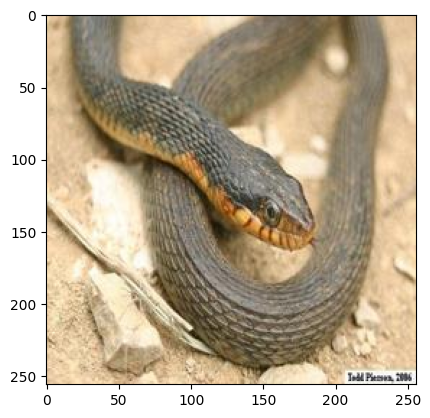

Image: 2_0275.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


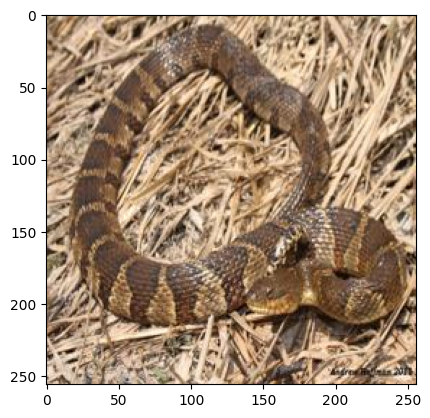

Image: 2_0302.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


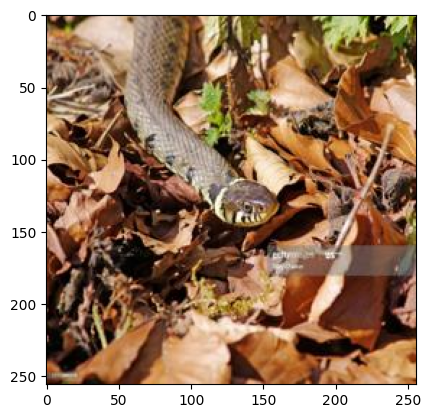

Image: 2_0316.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


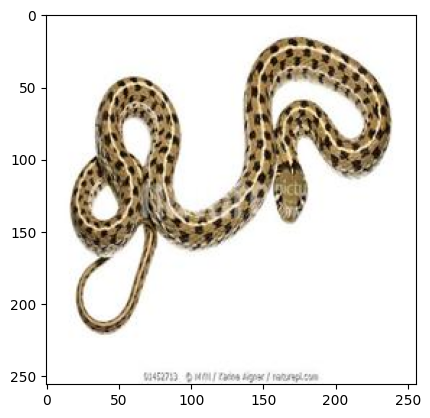

Image: 2_0328.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


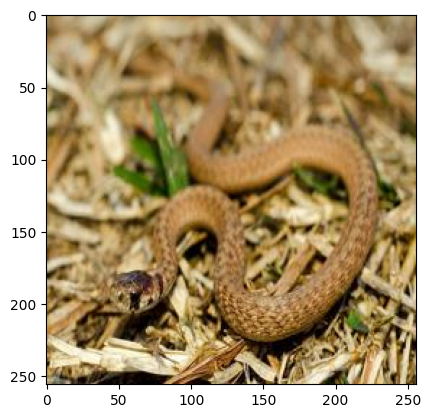

Image: 2_0333.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


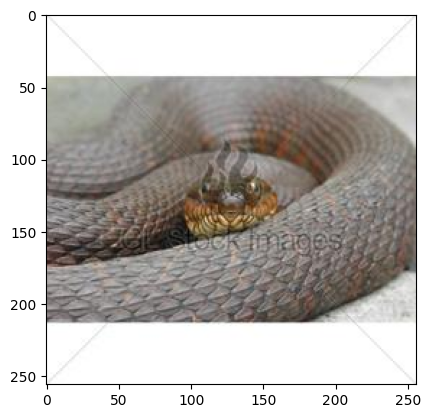

Image: 2_0336.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


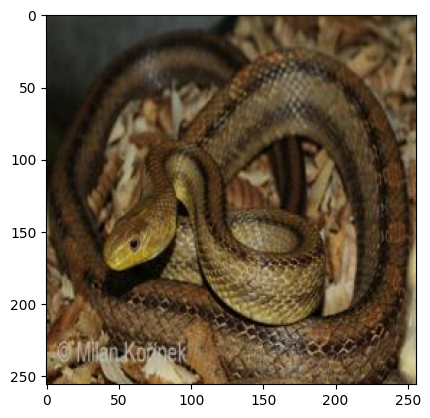

Image: 2_0416.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


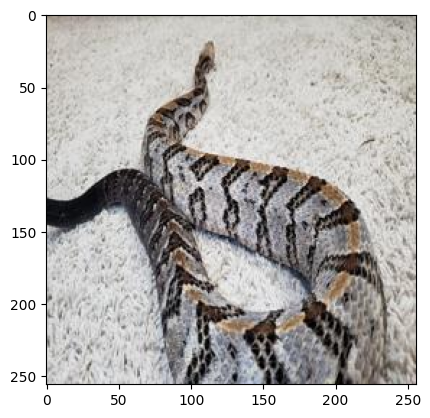

Image: 2_0419.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


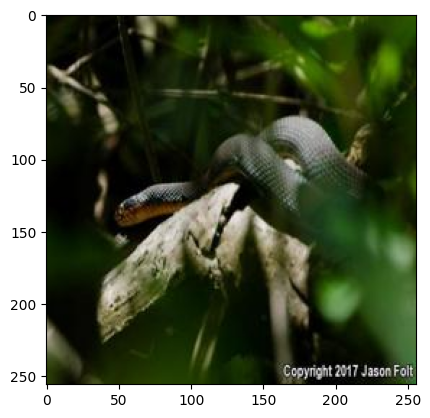

Image: 2_0489.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


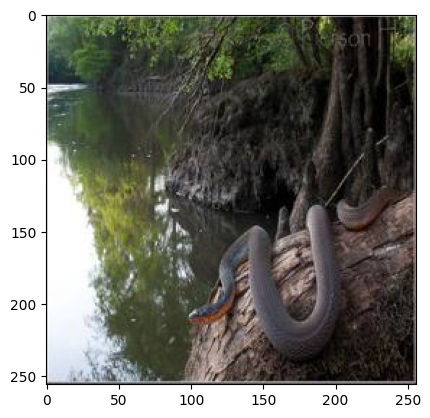

Image: 2_0496.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: snakes


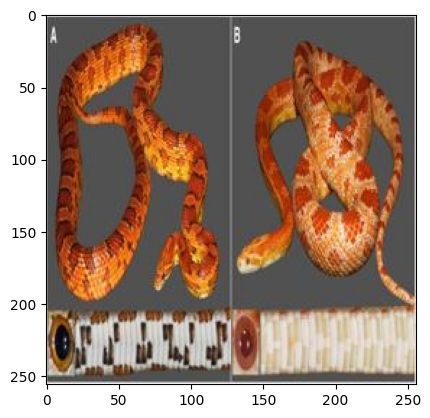

Image: 2_0501.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


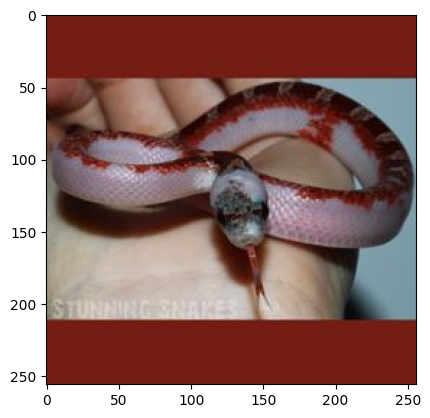

Image: 2_0504.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


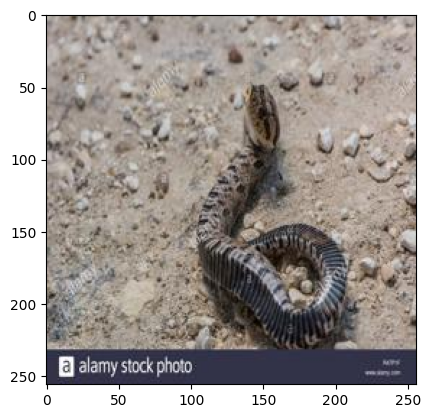

Image: 2_0551.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


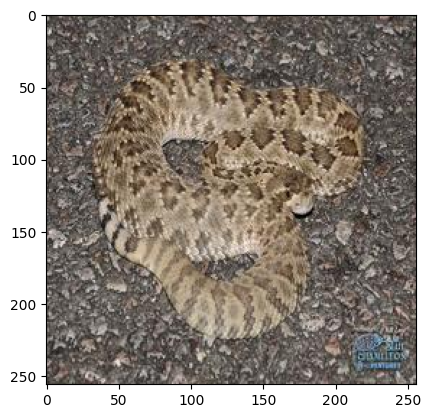

Image: 2_0572.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


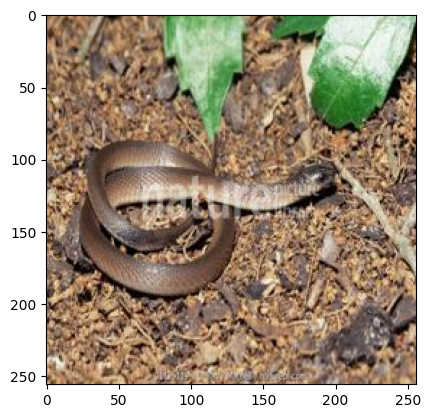

Image: 2_0592.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: snakes


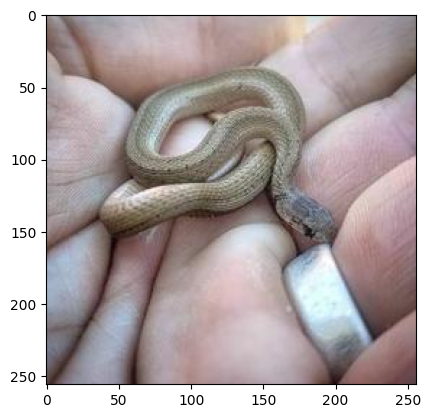

Image: 2_0611.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


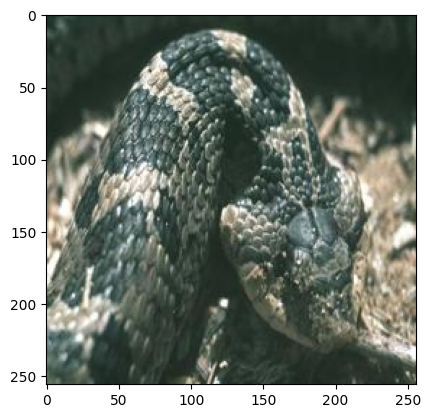

Image: 2_0626.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


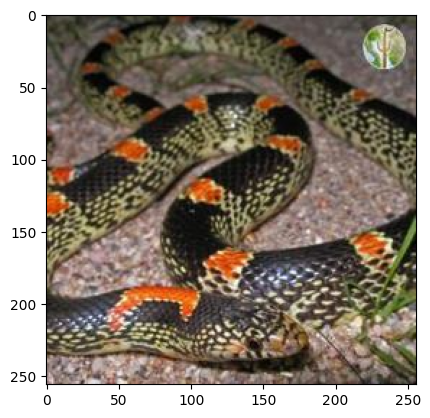

Image: 2_0640.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


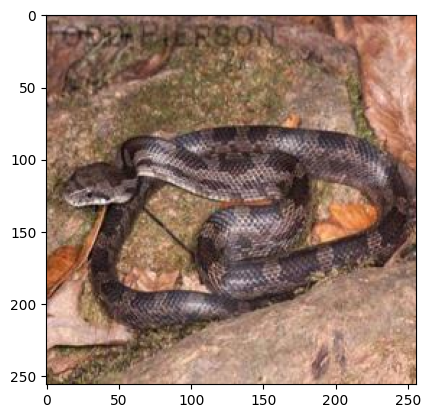

Image: 2_0643.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


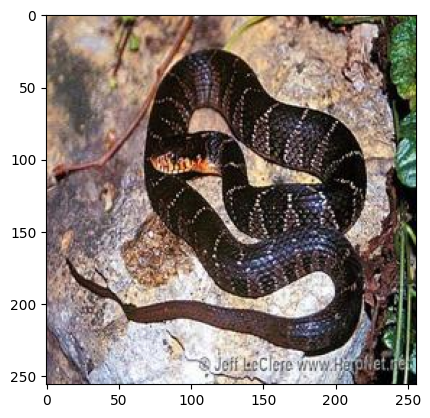

Image: 2_0645.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


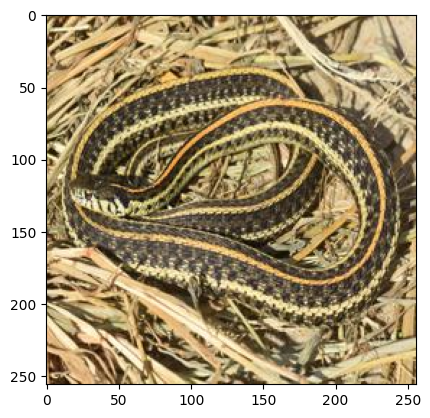

Image: 2_0665.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


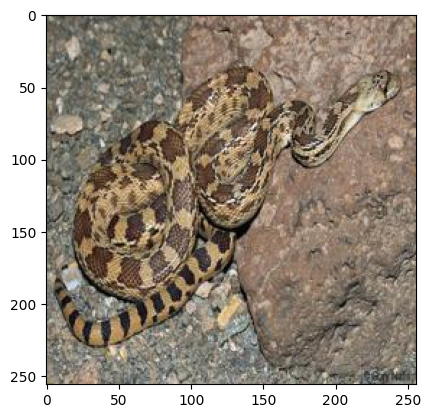

Image: 2_0673.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


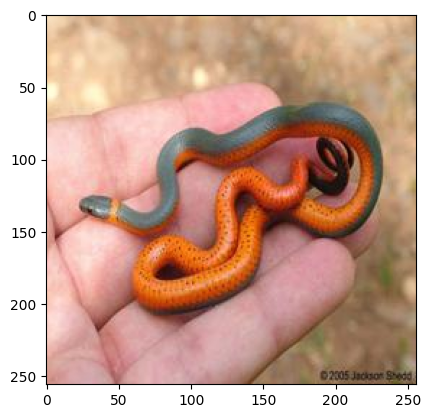

Image: 2_0712.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: snakes


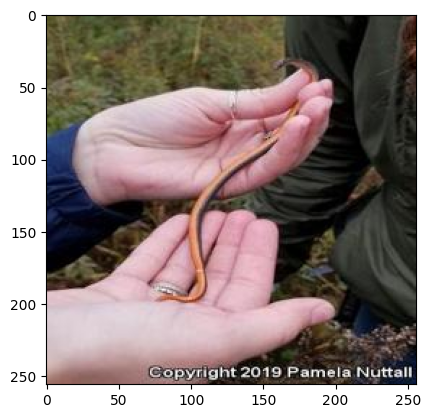

Image: 2_0725.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


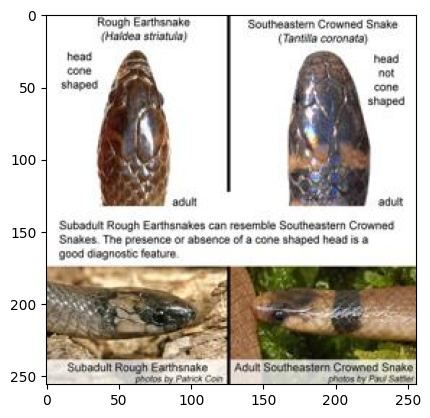

Image: 2_0730.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


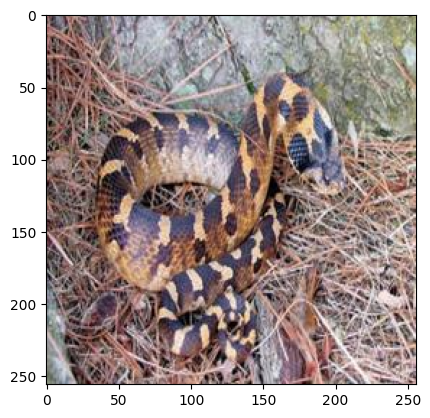

Image: 2_0745.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


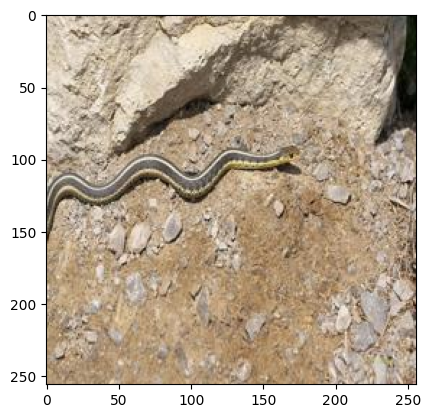

Image: 2_0774.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: snakes


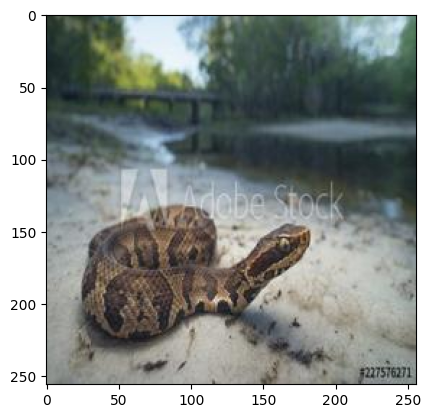

Image: 2_0790.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


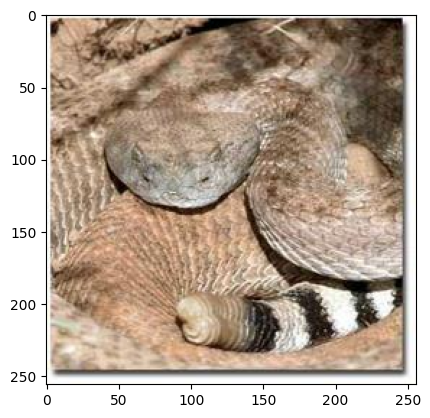

Image: 2_0792.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


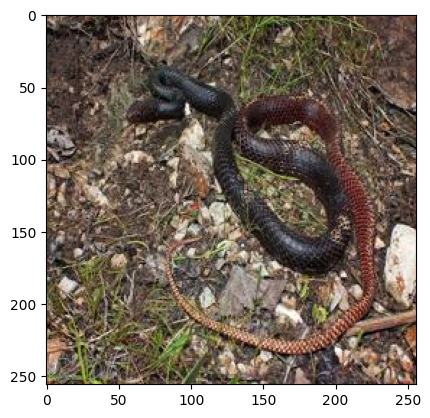

Image: 2_0800.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


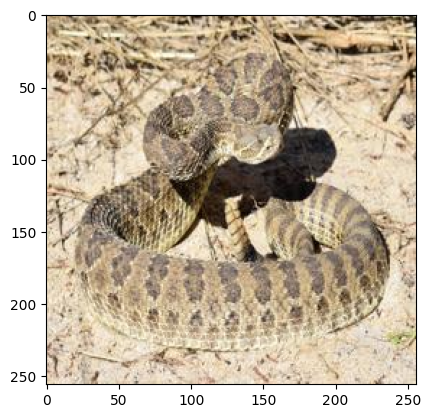

Image: 2_0808.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: cats


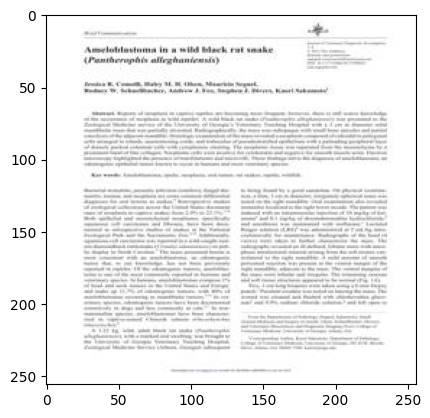

Image: 2_0828.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


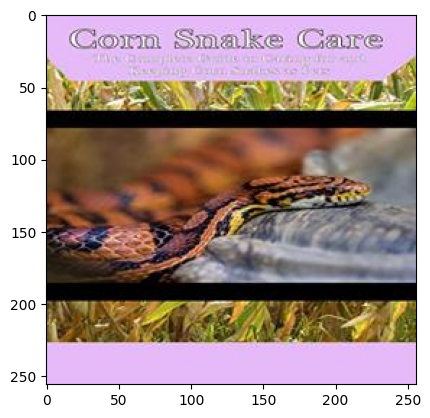

Image: 2_0853.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: snakes


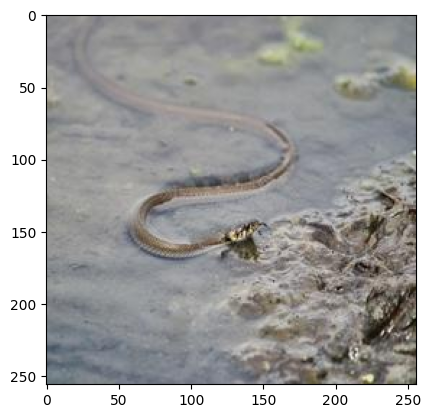

Image: 2_0900.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


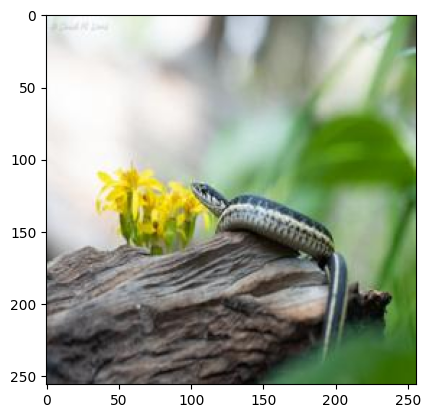

Image: 2_0910.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


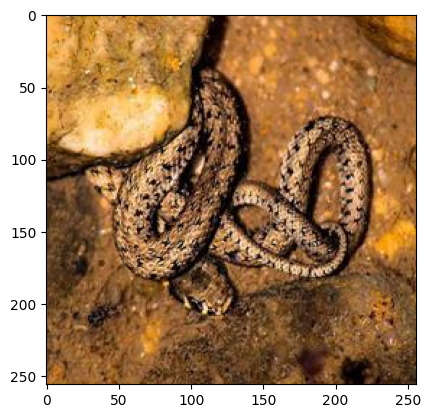

Image: 2_0925.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


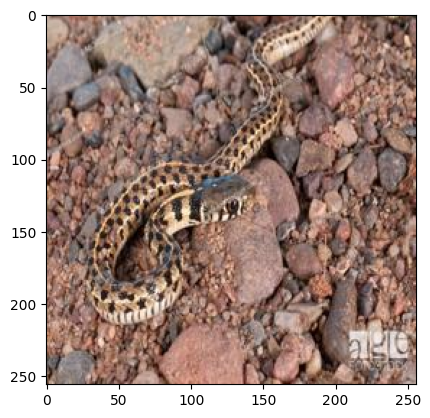

Image: 2_0948.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


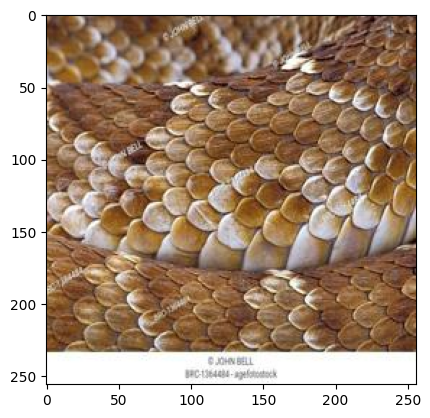

Image: 2_0952.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


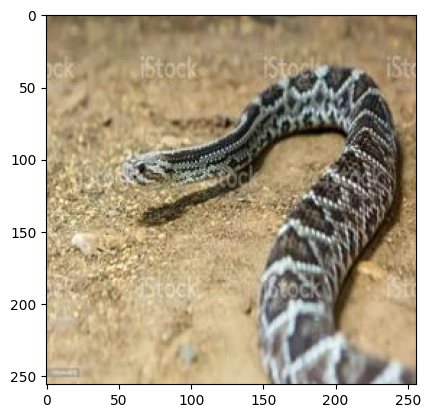

Image: 2_0961.jpg
Class predicted by model trained from scratch: snakes
Class predicted by fine-tuned pretrained model: snakes


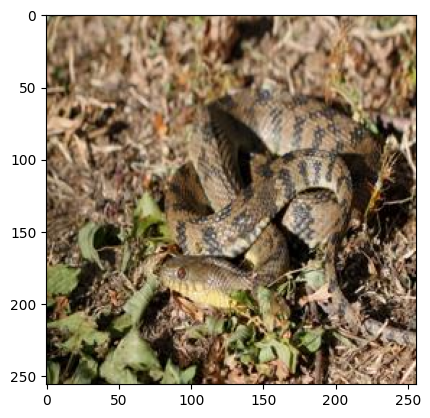

Image: 2_1000.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: snakes


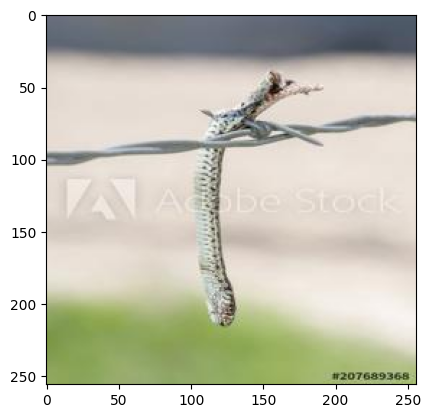

In [10]:
# prompt: i need the model classifies images at Animals_splitted/validate directory. It should output image and print it's class. Each image should be classified with both model_ft_scratch and model_ft_pretrained.

import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt

# Define transformations for validation images
data_transforms = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Path to the validation directory
validation_dir = 'Animals_splitted/validation'

# Iterate over images in the validation directory
for image_file in os.listdir(validation_dir):
    image_path = os.path.join(validation_dir, image_file)

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    image_tensor = data_transforms(image).unsqueeze(0).to(device)

    # Classify the image using both models
    with torch.no_grad():
        output_scratch = model_ft_scratch(image_tensor)
        _, pred_scratch = torch.max(output_scratch, 1)
        output_pretrained = model_ft_pretrained(image_tensor)
        _, pred_pretrained = torch.max(output_pretrained, 1)

    # Print the results
    print(f"Image: {image_file}")
    print(f"Class predicted by model trained from scratch: {class_names[pred_scratch.item()]}")
    print(f"Class predicted by fine-tuned pretrained model: {class_names[pred_pretrained.item()]}")

    # Display the image
    plt.imshow(image)
    plt.show()


Load petrained model from file

In [31]:
# Create the model structure again
model_ft_pretrained = models.resnet18(weights='IMAGENET1K_V1')

# Replace the final layer as before
num_ftrs = model_ft_pretrained.fc.in_features
model_ft_pretrained.fc = nn.Linear(num_ftrs, len(class_names))
model_ft_pretrained = model_ft_pretrained.to(device) # Send to GPU if available

# Load the state dictionary
#model_ft_pretrained.load_state_dict(torch.load('models/model_ft_pretrained.pth'))

# If you saved the entire model, including optimizer and other metadata
checkpoint = torch.load('models/model_ft_pretrained_full.pth')
model_ft_pretrained.load_state_dict(checkpoint['model_state_dict'])
optimizer_ft_pretrained.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']

# Now you can use the loaded model for inference or further training
model_ft_pretrained.eval() # Set the model to evaluation mode


C:\Users\volko\AppData\Local\Temp\ipykernel_27432\768244274.py:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('models/model_ft_pretrained_full.pth

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Validate on random images

Image: sub-buzz-1000-1685470041-3.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


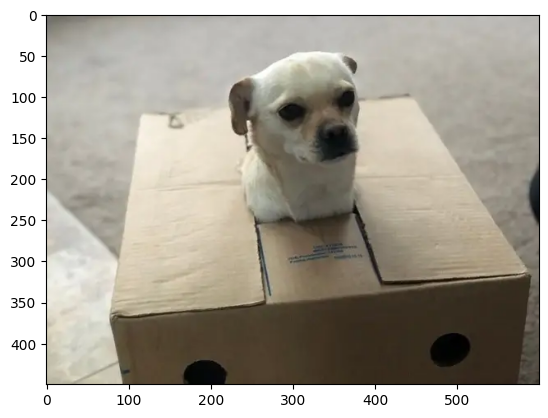

Image: sub-buzz-2420-1685470902-1.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


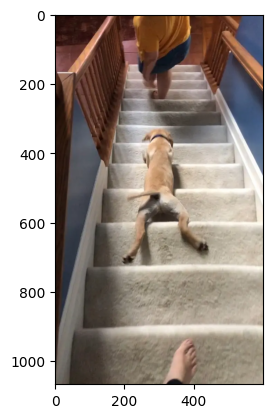

Image: sub-buzz-3399-1691014753-1.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


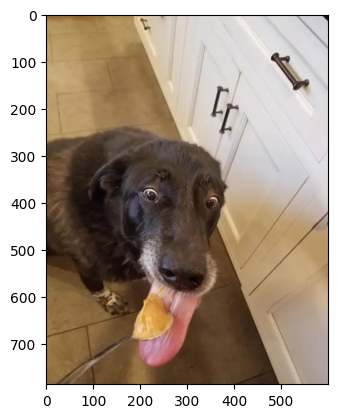

Image: weird-dog-pictures-1000-x-664-2wmea0in5o6gqjv2.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


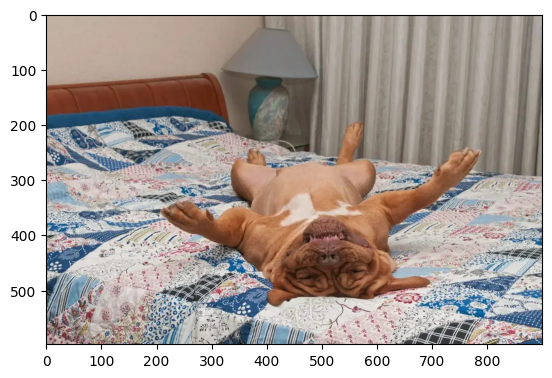

Image: weird-dog-pictures-1706-x-1706-67u3kutrbkqx35ry.jpg
Class predicted by model trained from scratch: cats
Class predicted by fine-tuned pretrained model: cats


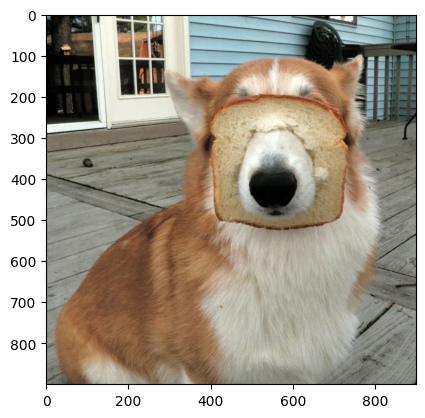

In [30]:
# prompt: i need the model classifies images at Animals_splitted/validate directory. It should output image and print it's class. Each image should be classified with both model_ft_scratch and model_ft_pretrained.

import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt

# Define transformations for validation images
data_transforms = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Path to the validation directory
validation_dir = 'validation'

# Iterate over images in the validation directory
for image_file in os.listdir(validation_dir):
    image_path = os.path.join(validation_dir, image_file)

    # Load and preprocess the image
    image = Image.open(image_path).convert('RGB')
    image_tensor = data_transforms(image).unsqueeze(0).to(device)

    # Classify the image using both models
    with torch.no_grad():
        output_scratch = model_ft_scratch(image_tensor)
        _, pred_scratch = torch.max(output_scratch, 1)
        output_pretrained = model_ft_pretrained(image_tensor)
        _, pred_pretrained = torch.max(output_pretrained, 1)

    # Print the results
    print(f"Image: {image_file}")
    print(f"Class predicted by model trained from scratch: {class_names[pred_scratch.item()]}")
    print(f"Class predicted by fine-tuned pretrained model: {class_names[pred_pretrained.item()]}")

    # Display the image
    plt.imshow(image)
    plt.show()
